<h1>Population Growth & Active Transportation Needs Analysis</h1>


<h4><b>Authored by: </b>Rhutuvaruni Kharade</h4>
<h4><b>Duration:</b> Approx 300 hours</h4>
<h4><b>Level: </b>Intermediate</h4>
<h4><b>Pre-requisite Skills: </b>Python, Intermediete Statistics, Linear Algebra</h4>

<h2><b>Introduction </b></h2>

The aim of this usecase is to conduct a comprehensive analysis of population growth trends across different regions within the City of Melbourne. The objective is to discern potential needs for enhancements in transportation services across various modes available throughout the city. As population densities evolve, ensuring commensurate provisions of stations and stops becomes imperative to facilitate public mobility to and from diverse locales. The overarching goal is to identify areas projected to experience significant population surges and to ascertain corresponding requirements for expanded transportation infrastructure in anticipation of such demographic shifts.


<h4>User Story:</h4><ul>
    <li> As a urban planner, I want to analyze historical and projected population data across different regions within Melbourne,    
So that I can identify areas with significant population growth and prioritize them for transportation infrastructure developmen..</l>
    <li>As a policy maker, 
I want to receive recommendations on areas for potential development or enhancement of transportation services,    
So that I can ensure these areas are equipped with the necessary infrastructure to support anticipated population surgs.</l
    <li>As a transportation planner,
I want to assess the current capacity and usage statistics of existing transportation modes (bus, metro, tram),    
So that I can propose where expansions or enhancements are needed based on population growth forecasts.</l
  u 
</ul>
ges.

<h4>What this use case will teach you</h4>

<div class="usecase-section-header">Analyzing population growth and sufficient amount of transportation services. </div>

<p>Using "City of Melbourne Population Forecasts by Small Area 2021-2041" dataset we will look at the forecasted population growth based on various features like location, year and value. This will help us understand what has been forecasted population growth in particular locations for particular years and the value of the growth in those areas. Using "City Circle tram stops" dataset we will look into the existing tram stops based on the locations where they exist. This will give us an insight into the number of tram stops in particular location. Using geolocation we can visualize the exact location of these tram stops to aid us into pointing out potential locations for future tram stops. Using "Bus stops" dataset we can see the location of bus stops within Melbourne city, thsi data can aid us to understand the existing number of bus stops in particular locations and if there are need for any more in the future due to the growth in the population. Dataset "Metro Train Stations with accessibility information"  gives information about the number of metro stations in various location in Melborune city. This dataset also contains the geolocations of the existing metro stations and using this we can predict if more metro stations will be needed in the future due to the growth in population. The initial approach would be to get the basic information about the dataset and understand the features within each dataset. Later figuring out which features are necessary and discarding the rest that are uncessary and only add to the number of dimensionality of the data. Once the features are understood, the goal will be to clean and remove null values with appropriate tools and techniques. After cleaning, a initial basic visualition to understand the overall distributions of the featues and finding out any correlations amongst them. Finally, using machine learning models to predict the number of transportation services that might be needed to aid the population growth within the city in particular locations. Potenitally, using PowerBI to the convey insights to the stakeholders/business owners/policy makers to help them understand the rise in population and their need for public transportation services, thus helping them plan for such resources beforehand.     </p>

<h2><b> Importing Libraries/ Packages</b> </h2>
<p>This part will focus on importing necessary libraries that will be used throughout this usecase. All libraries are imported in one block for ease and code cleanliness </p>


In [9]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
import requests
import pandas as pd 
from geopy.geocoders import ArcGIS
from geopy.geocoders import Nominatim 
from io import StringIO 
import folium
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score 
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score as ss
import haversine as hs

import warnings
from geopy.distance import geodesic
warnings.filterwarnings('ignore')


<h2><b>Collecting data from the source</b></h2>
<p>The following code blocks will collect data from the city of melbourne without the API key. </p>

In [10]:

# function to collect data 
def collect_data(dataset_id):
    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    dataset_id  = dataset_id
    format='csv'

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*', 
        'limit' : -1, 
        'lang' : 'en', 
        'timezone' : 'UTC' 
    }

    response = requests.get(url,params=params)

    if response.status_code ==200:
        url_content = response.content.decode('utf-8')
        dataset = pd.read_csv(StringIO(url_content), delimiter=';')
        return dataset
    else:
        print(f"Request failed with status code: {response.status_code}")


In [11]:
# population dataset 
dataset_id = 'city-of-melbourne-population-forecasts-by-small-area-2020-2040'
pop = collect_data(dataset_id)
print(len(pop))
pop.head()


17052


,geography,year,gender,age,value
0,City of Melbourne,2022,Female,Age 0-4,2212.0
1,City of Melbourne,2024,Female,Age 0-4,2818.0
2,City of Melbourne,2029,Female,Age 0-4,4310.0
3,City of Melbourne,2031,Female,Age 0-4,4736.0
4,City of Melbourne,2032,Female,Age 0-4,4931.0


In [12]:
# tram stop dataset 
dataset_id = 'city-circle-tram-stops'
tram = collect_data(dataset_id)
print(len(tram))
tram.head(3)

28


,geo_point_2d,geo_shape,name,xorg,stop_no,mccid_str,xsource,xdate,mccid_int
0,"-37.81922319307822, 144.9614014008424","{""coordinates"": [144.9614014008424, -37.819223...",Market Street / Flinders Street,GIS Team,3,NaN,Mapbase,2011-10-18,3
1,"-37.821539117626855, 144.95356912978238","{""coordinates"": [144.95356912978238, -37.82153...",Victoria Police Centre / Flinders Street,GIS Team,D6,NaN,Mapbase,2011-10-18,6
2,"-37.815426586135686, 144.94512063442602","{""coordinates"": [144.94512063442602, -37.81542...",Central Pier / Harbour Esplanade,GIS Team,D2,NaN,Mapbase,2011-10-18,10


In [13]:
# bus stop dataset 
dataset_id = 'bus-stops'
bus = collect_data(dataset_id)
print(len(bus))
bus.head(3)

309


,geo_point_2d,geo_shape,prop_id,addresspt1,addressp_1,asset_clas,asset_type,objectid,str_id,addresspt,asset_subt,model_desc,mcc_id,roadseg_id,descriptio,model_no
0,"-37.80384165792465, 144.93239283833262","{""coordinates"": [144.93239283833262, -37.80384...",0,76.819824,357,Signage,Sign - Public Transport,355,1235255,570648,NaN,Sign - Public Transport 1 Panel,1235255,21673,Sign - Public Transport 1 Panel Bus Stop Type 13,P.16
1,"-37.81548699581418, 144.9581794249902","{""coordinates"": [144.9581794249902, -37.815486...",0,21.561304,83,Signage,Sign - Public Transport,600,1231226,548056,NaN,Sign - Public Transport 1 Panel,1231226,20184,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16
2,"-37.81353897396532, 144.95728334230756","{""coordinates"": [144.95728334230756, -37.81353...",0,42.177187,207,Signage,Sign - Public Transport,640,1237092,543382,NaN,Sign - Public Transport 1 Panel,1237092,20186,Sign - Public Transport 1 Panel Bus Stop Type 8,P.16


In [14]:
# metro stations dataset 
dataset_id = 'metro-train-stations-with-accessibility-information'
metro = collect_data(dataset_id)
print(len(metro))
metro.head(3)

219


,geo_point_2d,geo_shape,he_loop,lift,pids,station
0,"-37.77839599999999, 145.031251","{""coordinates"": [145.031251, -37.7783959999999...",No,No,Dot Matrix,Alphington
1,"-37.86724899999996, 144.830604","{""coordinates"": [144.830604, -37.8672489999999...",No,No,LCD,Altona
2,"-37.761897999999974, 144.96056099999998","{""coordinates"": [144.96056099999998, -37.76189...",No,No,No,Anstey


<h2><b>Part 1: Preprocessing </b></h2>
<p>Initial preprocessing to handle null values, outliers, filling values and removing unecessary features/observations. </p>

<h4>1. Getting brief understanding of the dataset like number of features and observations, non null values, datatypes and dimension </h4>

In [15]:
# Population Dataset 
pop.info() 
print()
print(f"Num. of dimensions: {pop.shape}")


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17052 entries, 0 to 17051
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   geography  17052 non-null  object 
 1   year       17052 non-null  int64  
 2   gender     17052 non-null  object 
 3   age        17052 non-null  object 
 4   value      16989 non-null  float64
dtypes: float64(1), int64(1), object(3)
memory usage: 666.2+ KB

Num. of dimensions: (17052, 5)


In [16]:
# tram stop dataset 
tram.info()
print()
print(f"Num. of dimensions: {tram.shape}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28 entries, 0 to 27
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  28 non-null     object 
 1   geo_shape     28 non-null     object 
 2   name          28 non-null     object 
 3   xorg          28 non-null     object 
 4   stop_no       28 non-null     object 
 5   mccid_str     0 non-null      float64
 6   xsource       28 non-null     object 
 7   xdate         28 non-null     object 
 8   mccid_int     28 non-null     int64  
dtypes: float64(1), int64(1), object(7)
memory usage: 2.1+ KB

Num. of dimensions: (28, 9)


In [17]:
# metro stations datasetabs 
metro.info()

print()
print(f"Num. of dimensions: {metro.shape}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   geo_point_2d  219 non-null    object
 1   geo_shape     219 non-null    object
 2   he_loop       219 non-null    object
 3   lift          219 non-null    object
 4   pids          219 non-null    object
 5   station       219 non-null    object
dtypes: object(6)
memory usage: 10.4+ KB

Num. of dimensions: (219, 6)


In [18]:
# bus stop dataset information   
bus.info()
print()
print(f"Num. of dimensions: {bus.shape}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309 entries, 0 to 308
Data columns (total 16 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  309 non-null    object 
 1   geo_shape     309 non-null    object 
 2   prop_id       309 non-null    int64  
 3   addresspt1    309 non-null    float64
 4   addressp_1    309 non-null    int64  
 5   asset_clas    309 non-null    object 
 6   asset_type    309 non-null    object 
 7   objectid      309 non-null    int64  
 8   str_id        309 non-null    int64  
 9   addresspt     309 non-null    int64  
 10  asset_subt    0 non-null      float64
 11  model_desc    309 non-null    object 
 12  mcc_id        309 non-null    int64  
 13  roadseg_id    309 non-null    int64  
 14  descriptio    309 non-null    object 
 15  model_no      309 non-null    object 
dtypes: float64(2), int64(7), object(7)
memory usage: 38.8+ KB

Num. of dimensions: (309, 16)


<h4>2. The summation of null values across features provides insights into the extent of missing data within each feature for a particular dataset   </h4>

In [19]:
pop.isnull().sum() 

geography     0
year          0
gender        0
age           0
value        63
dtype: int64

In [20]:
tram.isnull().sum()

geo_point_2d     0
geo_shape        0
name             0
xorg             0
stop_no          0
mccid_str       28
xsource          0
xdate            0
mccid_int        0
dtype: int64

In [21]:
metro.isnull().sum()

geo_point_2d    0
geo_shape       0
he_loop         0
lift            0
pids            0
station         0
dtype: int64

In [22]:
bus.isnull().sum()

geo_point_2d      0
geo_shape         0
prop_id           0
addresspt1        0
addressp_1        0
asset_clas        0
asset_type        0
objectid          0
str_id            0
addresspt         0
asset_subt      309
model_desc        0
mcc_id            0
roadseg_id        0
descriptio        0
model_no          0
dtype: int64

<h4>3. Handling null values </h4>

<p>Only need for Population, bus and tram dataset. No null values in metro dataset.</p>
<b>Population dataset </b>
<ul>
    <li>Finding out where (which row indexes) the null values in the dataset exist.</li>
    <li>As the data type of missing value columns is numeric, replacing with median</li>
    <li>Rechecking if missing values handled or not</li>
</ul>

In [23]:
# All missing data is numerical hence can be replaced by median 
pop.loc[pop.value.isna(),:]     

# 5574 to 16921 (68 rows)- Mostly West Melbourne (industrial) values are missing

# finding what is the median value for observations from West Melbourne (Industrial) specifically as 
# most missing values are from this area/location alone 
median = float(pop.loc[pop.geography == "West Melbourne (Industrial)"].value.median())
print(median)

# Filling the missing values with median 
pop = pop.fillna(median)

# null val check
pop.isnull().sum()

# all missing values are handled successfully 


0.0


geography    0
year         0
gender       0
age          0
value        0
dtype: int64


<b>Tram dataset </b>
<ul>
    <li>Checking values in "mccid_str" columns to see potential replacement options.</li>
    <li>All values in the column are null so this column can be dropped altogether.</li>
    <li>Rechecking if missing values handled or not (Kernal run all cell required each time).</li>
</ul>

In [24]:
# checkign which columns has missing values 
tram.isna().sum()

# mccid_str 
tram.mccid_str

# all data in this col is null so this entire col can be removed all together
tram = tram.drop(columns="mccid_str", axis=1, inplace=False)
tram.head(5)


,geo_point_2d,geo_shape,name,xorg,stop_no,xsource,xdate,mccid_int
0,"-37.81922319307822, 144.9614014008424","{""coordinates"": [144.9614014008424, -37.819223...",Market Street / Flinders Street,GIS Team,3,Mapbase,2011-10-18,3
1,"-37.821539117626855, 144.95356912978238","{""coordinates"": [144.95356912978238, -37.82153...",Victoria Police Centre / Flinders Street,GIS Team,D6,Mapbase,2011-10-18,6
2,"-37.815426586135686, 144.94512063442602","{""coordinates"": [144.94512063442602, -37.81542...",Central Pier / Harbour Esplanade,GIS Team,D2,Mapbase,2011-10-18,10
3,"-37.813414856197724, 144.94137823870162","{""coordinates"": [144.94137823870162, -37.81341...",New Quay Promenade / Docklands Drive,GIS Team,D10,Mapbase,2011-10-18,11
4,"-37.814591782869805, 144.94655055842398","{""coordinates"": [144.94655055842398, -37.81459...",Etihad Statium / La Trobe Street,GIS Team,D1,Mapbase,2011-10-18,13


In [25]:
# null val check 
tram.isna().sum()

# all missing values handled successfuly

geo_point_2d    0
geo_shape       0
name            0
xorg            0
stop_no         0
xsource         0
xdate           0
mccid_int       0
dtype: int64


<b>Bus dataset </b>
<ul>
    <li>Checking values in "asset_subt" columns to see potential replacement options.</li>
</ul>

In [26]:
bus.isna().sum()

# checkign the asset_subt column
bus.asset_subt

# all null values , so col can be removed 
bus = bus.drop(columns="asset_subt",axis=1,inplace=False )

In [27]:
# null val check
bus.isna().sum()

geo_point_2d    0
geo_shape       0
prop_id         0
addresspt1      0
addressp_1      0
asset_clas      0
asset_type      0
objectid        0
str_id          0
addresspt       0
model_desc      0
mcc_id          0
roadseg_id      0
descriptio      0
model_no        0
dtype: int64

<h4>4. Removing unnecessary features/irrelevant observations/Outliers </h4>

<p>Population dataset </p>
<ul>
    <li>Removing "gender" and "age" column- Aim is to look at the overall growth in population, regardless of gender or age of population </li>
    <li>Scaling the "value" values. </li>
</ul>

In [28]:
pop=pop.drop_duplicates()

In [29]:
pop=pop[pop.age == "Total population"]

In [30]:
pop = pop.drop(columns=["gender", "age"], axis=1, inplace=False)

In [31]:
# drop check
pop.head(10)

,geography,year,value
5620,City of Melbourne,2021,153674.0
5621,City of Melbourne,2025,178786.0
5622,City of Melbourne,2028,213048.0
5623,City of Melbourne,2029,223062.0
5624,City of Melbourne,2033,257702.0
5625,City of Melbourne,2038,291496.0
5626,City of Melbourne,2040,302903.0
5627,Carlton,2026,20743.0
5628,Carlton,2027,21679.0
5629,Carlton,2031,26375.0


In [32]:
np.sort(pop.year.unique())

array([2021, 2022, 2023, 2024, 2025, 2026, 2027, 2028, 2029, 2030, 2031,
       2032, 2033, 2034, 2035, 2036, 2037, 2038, 2039, 2040, 2041],
      dtype=int64)

<p>Scaling population dataset so that the values are between the 0 to 1  </p>

In [33]:
# min max scalign
pop.value = (pop.value - min(pop.value))/(max(pop.value) - min(pop.value))
pop.head()

# value is now scaled 

,geography,year,value
5620,City of Melbourne,2021,0.498634
5621,City of Melbourne,2025,0.580116
5622,City of Melbourne,2028,0.691288
5623,City of Melbourne,2029,0.723781
5624,City of Melbourne,2033,0.836179


In [34]:
# pip install geopy

<p>Code to convert the names of locations into their corrsponding longitude and latitude</p>

In [35]:
# this code takes too long and consumes resources  if unique() is removed


location = Nominatim(user_agent="Geopy Library")

main = {}   # the main list that collects latititude and longitude

for city in pop.geography.unique():
    city = str(city)

    try:
        city = str(city) + ",Victoria, Australia"     
        getLoc = location.geocode(city)
        main[city] = (getLoc.latitude,getLoc.longitude)
        # longitude.append(getLoc.longitude)
        print(getLoc.address)
    except:
        main[city] = (None, None)
        print(f"NOT FOUND : {city}")
        pass


City of Melbourne, Victoria, Australia
Carlton, Melbourne, City of Melbourne, Victoria, 3053, Australia
Docklands, Melbourne, City of Melbourne, Victoria, 3008, Australia
East Melbourne, Melbourne, City of Melbourne, Victoria, 3002, Australia
Kensington, Bellair Street, Kensington, Melbourne, City of Melbourne, Victoria, 3031, Australia
Melbourne, City of Melbourne, Victoria, Australia
NOT FOUND : Melbourne (Remainder),Victoria, Australia
North Melbourne, Dryburgh Street, West Melbourne, Melbourne, City of Melbourne, Victoria, 3003, Australia
Parkville, Melbourne, City of Melbourne, Victoria, 3052, Australia
Port Melbourne, Melbourne, City of Port Phillip, Victoria, 3207, Australia
South Yarra, Melbourne, City of Stonnington, Victoria, 3141, Australia
Southbank, Melbourne, City of Melbourne, Victoria, 3006, Australia
Australia Post Sunshine West PDC, 42, Industrial Drive, Sunshine West, Melbourne, City of Brimbank, Victoria, 3020, Australia
NOT FOUND : West Melbourne (Residential),Vict

In [36]:
main

{'City of Melbourne,Victoria, Australia': (-37.8123825, 144.94826486608156),
 'Carlton,Victoria, Australia': (-37.8004228, 144.9684343),
 'Docklands,Victoria, Australia': (-37.8175423, 144.9394923),
 'East Melbourne,Victoria, Australia': (-37.812498, 144.9858851),
 'Kensington,Victoria, Australia': (-37.7939378, 144.9305645),
 'Melbourne (CBD),Victoria, Australia': (-37.8141705, 144.9655616),
 'Melbourne (Remainder),Victoria, Australia': (None, None),
 'North Melbourne,Victoria, Australia': (-37.8076092, 144.9423514),
 'Parkville,Victoria, Australia': (-37.7871148, 144.9515533),
 'Port Melbourne,Victoria, Australia': (-37.8333613, 144.9219203),
 'South Yarra,Victoria, Australia': (-37.8377695, 144.9918537),
 'Southbank,Victoria, Australia': (-37.8253618, 144.9640203),
 'West Melbourne (Industrial),Victoria, Australia': (-37.8083671,
  144.81306234897477),
 'West Melbourne (Residential),Victoria, Australia': (None, None)}

<p>Tram dataset </p>
<ul>
    <li>Removing xorg, xsource, mccid_int, xdate column - None of these columns are useful as tehy dont give information about the location of tram stop itself.  </li>
    <li>Seperated the geo_shape_2d column into latitude and longitude and later dropped it. </li>
    
</ul>

In [37]:
tram = tram.drop(columns=["xorg", "xsource", "xdate", "mccid_int", "stop_no"], inplace=False, axis=1 )

In [38]:
# drop check
tram.head(10)

,geo_point_2d,geo_shape,name
0,"-37.81922319307822, 144.9614014008424","{""coordinates"": [144.9614014008424, -37.819223...",Market Street / Flinders Street
1,"-37.821539117626855, 144.95356912978238","{""coordinates"": [144.95356912978238, -37.82153...",Victoria Police Centre / Flinders Street
2,"-37.815426586135686, 144.94512063442602","{""coordinates"": [144.94512063442602, -37.81542...",Central Pier / Harbour Esplanade
3,"-37.813414856197724, 144.94137823870162","{""coordinates"": [144.94137823870162, -37.81341...",New Quay Promenade / Docklands Drive
4,"-37.814591782869805, 144.94655055842398","{""coordinates"": [144.94655055842398, -37.81459...",Etihad Statium / La Trobe Street
5,"-37.812487918072826, 144.95393532833103","{""coordinates"": [144.95393532833103, -37.81248...",King Street / La Trobe Street
6,"-37.8081489607039, 144.96879323779422","{""coordinates"": [144.96879323779422, -37.80814...",Exhibition Street / La Trobe Street
7,"-37.81538859129167, 144.97453393804187","{""coordinates"": [144.97453393804187, -37.81538...",Spring Street / Flinders Street
8,"-37.81614537491179, 144.97196946163052","{""coordinates"": [144.97196946163052, -37.81614...",Exhibition Street / Flinders Street
9,"-37.82023778673241, 144.95786314283018","{""coordinates"": [144.95786314283018, -37.82023...",Melbourne Aquarium / Flinders Street


In [39]:
# seperating the geolocation columns
tram[["lat_tram", "lon_tram"]] = tram.geo_point_2d.str.split(',', expand=True).astype(float)
# tram.head(5)
tram = tram.drop(columns=["geo_point_2d", "geo_shape"], inplace=False, axis=1)


# renaming the name column to tram_stop_name to be more specific
tram = tram.rename(columns={"name":"stop_name"})

In [40]:
# final check 
tram.head(10)

,stop_name,lat_tram,lon_tram
0,Market Street / Flinders Street,-37.819223,144.961401
1,Victoria Police Centre / Flinders Street,-37.821539,144.953569
2,Central Pier / Harbour Esplanade,-37.815427,144.945121
3,New Quay Promenade / Docklands Drive,-37.813415,144.941378
4,Etihad Statium / La Trobe Street,-37.814592,144.946551
5,King Street / La Trobe Street,-37.812488,144.953935
6,Exhibition Street / La Trobe Street,-37.808149,144.968793
7,Spring Street / Flinders Street,-37.815389,144.974534
8,Exhibition Street / Flinders Street,-37.816145,144.971969
9,Melbourne Aquarium / Flinders Street,-37.820238,144.957863


<p>Bus dataset </p>
<ul>
    <li>Removing prop_id, asset_clas, objectid, str_id, model_desc, mcc_id, roadseg_id, model_no column - None of these columns are useful as they dont give information about the location of the bus stop itself.  </li>
    <li>Seperated the geo_shape_2d column into latitude and longitude and later dropped it. </li>
    
</ul>

In [41]:
bus = bus.drop(columns= [
    "prop_id", 
    "asset_clas", 
    'asset_type', 
    'str_id', 
    'model_desc',
    'mcc_id', 
    "roadseg_id", 
    "model_no",
    "addresspt1", 
    "addressp_1",
    "objectid",
    "addresspt", 
    "descriptio"
], inplace=False, axis=1)

In [42]:
bus.head(10)

,geo_point_2d,geo_shape
0,"-37.80384165792465, 144.93239283833262","{""coordinates"": [144.93239283833262, -37.80384..."
1,"-37.81548699581418, 144.9581794249902","{""coordinates"": [144.9581794249902, -37.815486..."
2,"-37.81353897396532, 144.95728334230756","{""coordinates"": [144.95728334230756, -37.81353..."
3,"-37.82191394843844, 144.95539345270072","{""coordinates"": [144.95539345270072, -37.82191..."
4,"-37.83316401267591, 144.97443745130263","{""coordinates"": [144.97443745130263, -37.83316..."
5,"-37.79436108568101, 144.92998424529242","{""coordinates"": [144.92998424529242, -37.79436..."
6,"-37.817452093555325, 144.96168480565794","{""coordinates"": [144.96168480565794, -37.81745..."
7,"-37.82146476463953, 144.9303191551562","{""coordinates"": [144.9303191551562, -37.821464..."
8,"-37.837547087144706, 144.98191138368836","{""coordinates"": [144.98191138368836, -37.83754..."
9,"-37.812490976626215, 144.95370614040704","{""coordinates"": [144.95370614040704, -37.81249..."


In [43]:
# seperating the geo_point_2d to lat and lon column 
bus[["lat_bus", "lon_bus"]] =  bus.geo_point_2d.str.split(',', expand=True).astype(float)
# drop the original cols 
bus = bus.drop(columns=["geo_point_2d", "geo_shape"], inplace=False, axis=1)

In [44]:
bus.head(10)

,lat_bus,lon_bus
0,-37.803842,144.932393
1,-37.815487,144.958179
2,-37.813539,144.957283
3,-37.821914,144.955393
4,-37.833164,144.974437
5,-37.794361,144.929984
6,-37.817452,144.961685
7,-37.821465,144.930319
8,-37.837547,144.981911
9,-37.812491,144.953706


<p>Metro dataset </p>
<ul>
    <li>Removing pids, he_loop, lift column - None of these columns are useful as they dont give information about the location of the metro station.  </li>
    <li>Seperated the geo_shape_2d column into latitude and longitude and later dropped it. </li>
</ul>

In [45]:
metro[["lat_metro", "lon_metro"]] =  metro.geo_point_2d.str.split(',', expand=True).astype(float)
# drop the original cols 
metro = metro.drop(columns=["geo_point_2d", "geo_shape", "he_loop", "lift", "pids"], inplace=False, axis=1)
# renamign col
metro = metro.rename(columns={"station":"station_name"})

In [46]:
# check updates
metro.head(10)

,station_name,lat_metro,lon_metro
0,Alphington,-37.778396,145.031251
1,Altona,-37.867249,144.830604
2,Anstey,-37.761898,144.960561
3,Auburn,-37.822411,145.045617
4,Batman,-37.733459,144.962747
5,Beaconsfield,-38.050928,145.366045
6,Bell,-37.745568,145.000181
7,Berwick,-38.039681,145.344973
8,Box Hill,-37.819274,145.121800
9,Burwood,-37.851351,145.080368


In [47]:
# final shapes of all datasets 
print(f"Shape of population dataset: {pop.shape}")
print(f"Shape of bus stops dataset: {bus.shape}")
print(f"Shape of tram stop dataset: {tram.shape}")
print(f"Shape of metro stations dataset: {metro.shape}")

Shape of population dataset: (294, 3)
Shape of bus stops dataset: (309, 2)
Shape of tram stop dataset: (28, 3)
Shape of metro stations dataset: (219, 3)


<h2><b>Visualizations </b></h2>
<p>The following code blocks will briefly visualize the information in our dataset. This is just a initial visualization to understand the overall pattern in our data.  </p>

<b>Population dataset </b>


In [48]:
pop.head(5)

,geography,year,value
5620,City of Melbourne,2021,0.498634
5621,City of Melbourne,2025,0.580116
5622,City of Melbourne,2028,0.691288
5623,City of Melbourne,2029,0.723781
5624,City of Melbourne,2033,0.836179


The code below takes the latitude and longitude from the datasets and finds their location on map. If a particular location is not found the code outputs a "CITY NOT FOUND" message. Finally a new dataframe is created to store the information for latitude and longitude and corresponding city name.

In [49]:
geolocator = Nominatim(user_agent="location_details")

new_df = pd.DataFrame()

city_list = list()
lat_list = list()
long_list = list()

for city in pop.geography.unique():
    city = f"{city}, Victoria, Australia"
    try: 
        location = geolocator.geocode(city)
        # print((location.address,  location.latitude, location.longitude))
        lat_list.append(location.latitude)
        long_list.append(location.longitude)
        # print()
        city_list.append(location.address.split(",")[0])
        map=folium.Map(location=[location.latitude, location.longitude],zoom_start=15)
        map.add_child(folium.Marker(location=[location.latitude, location.longitude],popup=location,icon=folium.Icon(color='blue')))
        
    except:
        print(f"CITY NOT FOUND: {city}")
        

new_df['geography'] = np.array(city_list)
new_df['city_lat']   = np.array(lat_list)
new_df['city_long'] = np.array(long_list)


new_df
pop_lat_long = new_df
pop_lat_long
# location = geolocator.geocode("Carlton, Victoria, Australia")
# print((location.latitude, location.longitude))



CITY NOT FOUND: Melbourne (Remainder), Victoria, Australia
CITY NOT FOUND: West Melbourne (Residential), Victoria, Australia


,geography,city_lat,city_long
0,City of Melbourne,-37.812382,144.948265
1,Carlton,-37.800423,144.968434
2,Docklands,-37.817542,144.939492
3,East Melbourne,-37.812498,144.985885
4,Kensington,-37.793938,144.930565
5,Melbourne,-37.814171,144.965562
6,North Melbourne,-37.807609,144.942351
7,Parkville,-37.787115,144.951553
8,Port Melbourne,-37.833361,144.921920
9,South Yarra,-37.837770,144.991854


In [50]:
city_names = list(pop.geography.unique())
# city_names

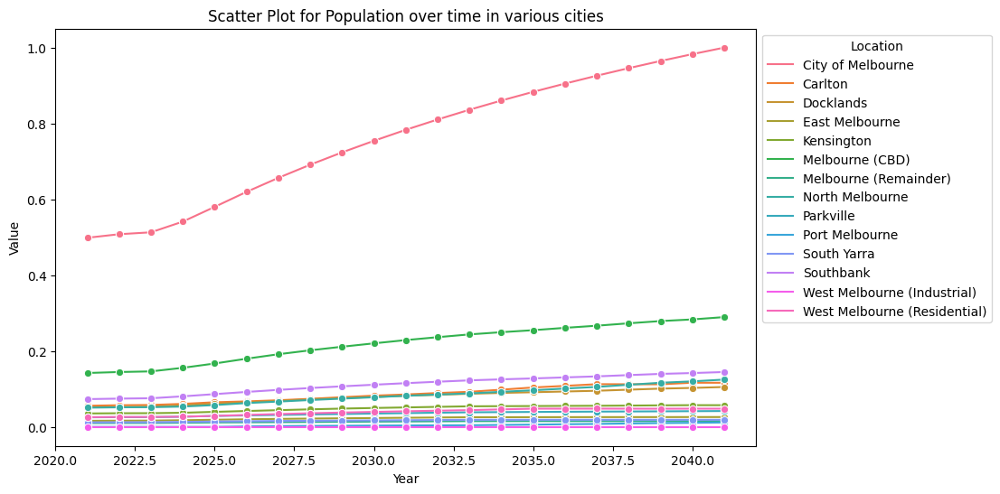

In [51]:
x = pop[pop.geography.isin(city_names)]


plt.figure(figsize=(10,6))
plot= sns.lineplot(data=x, x='year', y='value', hue='geography', marker='o')
plt.title('Scatter Plot for Population over time in various cities')
plt.xlabel('Year')
plt.ylabel('Value')
plt.legend(title='Location')
sns.move_legend(plot, "upper left", bbox_to_anchor=(1, 1))

<p><b>Key findings from the plot: </b></p>
This scatterplot visualizes population growth trends over time for various locations within Melbourne. Here's what can be understood from the plot:

1. **Dominant Growth in the City of Melbourne**: The red line, representing the City of Melbourne, shows a strong upward trend, indicating a significant increase in population from 2020 to 2040. This area is experiencing more substantial growth compared to other locations.

2. **Stable Populations in Other Areas**: The green line, representing Carlton, and other colored lines for various districts such as Docklands, East Melbourne, and others, show relatively stable populations over the same period. These lines are mostly flat, indicating little to no growth in population.

3. **Cluster of Locations with Minimal Change**: Most of the other locations represented by various colors remain nearly constant over the years. This suggests that while the central area of Melbourne is growing, other districts are not experiencing similar population increases.

4. **Potential Focus for Infrastructure Development**: Given the significant growth in the City of Melbourne, there might be an increased need for infrastructure and transportation services in this area to accommodate the rising population.

5. **Comparison of Growth Rates**: The graph allows for an easy comparison of growth rates between the central business district and the outlying areas, highlighting areas that might require more attention from urban planners and policymakers.

Overall, this plot is crucial for planning and resource allocation, especially in targeting areas with rapid population growth for transportation and infrastructure development.icdpment.
</ul>

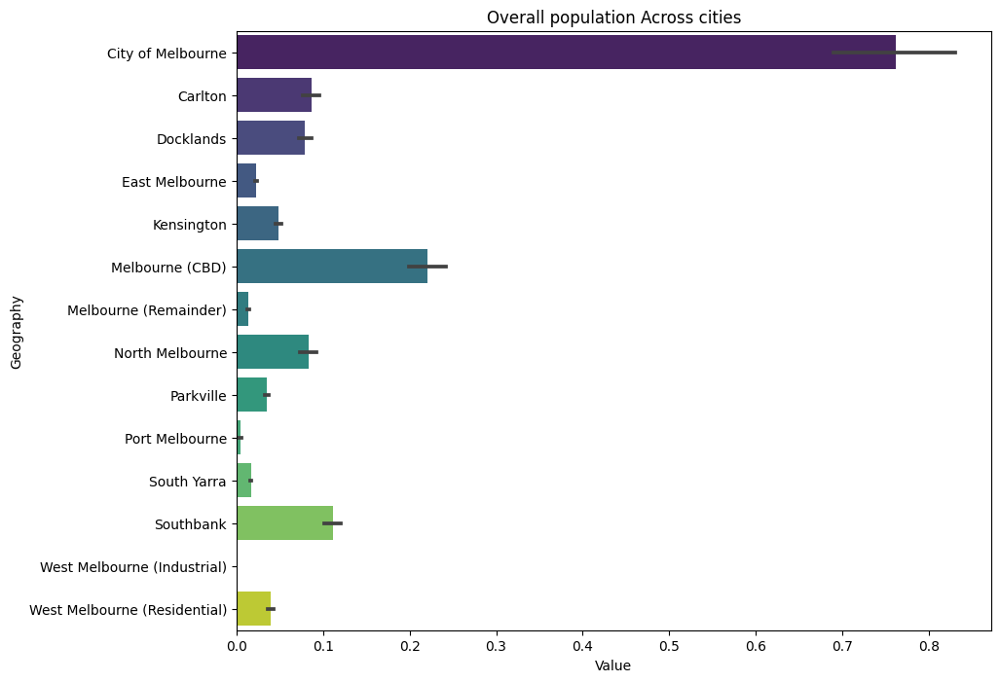

In [52]:
# bar plot 
plt.figure(figsize=(10, 8))
sns.barplot(data=pop, x='value', y='geography', palette='viridis')
plt.title(f'Overall population Across cities')
plt.xlabel('Value')
plt.ylabel('Geography')
plt.show()

This bar chart visualizes the overall population distribution across various geographic areas within Melbourne. Here’s what can be understood from the plot:

1. **Dominant Population in the City of Melbourne**: The bar for the City of Melbourne is significantly longer than for any other area, indicating that it has a much higher population compared to other parts of the city.

2. **Comparatively Lower Populations in Other Areas**: Areas like Carlton, Docklands, and Kensington have relatively smaller populations, as shown by the shorter bars.

3. **Minimal Population in Some Suburbs**: Areas like Southbank, West Melbourne (both Industrial and Residential), and Port Melbourne have even smaller populations relative to the central and other urban areas, indicated by the shortest bars.

4. **Potential Areas for Infrastructure Focus**: Given the high population in the City of Melbourne, this area might require more robust transportation and infrastructure services. Conversely, areas with smaller populations might be evaluated for potential growth or revitalization projects.

5. **Strategic Planning for Service Allocation**: Urban planners and decision-makers can use this data to strategically plan resource allocation, ensuring that areas with higher populations are adequately served, potentially planning for expansion in areas showing a potential for growth.

Overall, this plot serves as a crucial tool for understanding how population is spread across Melbourne, guiding decisions related to urban planning, transportation services, and infrastructure development.

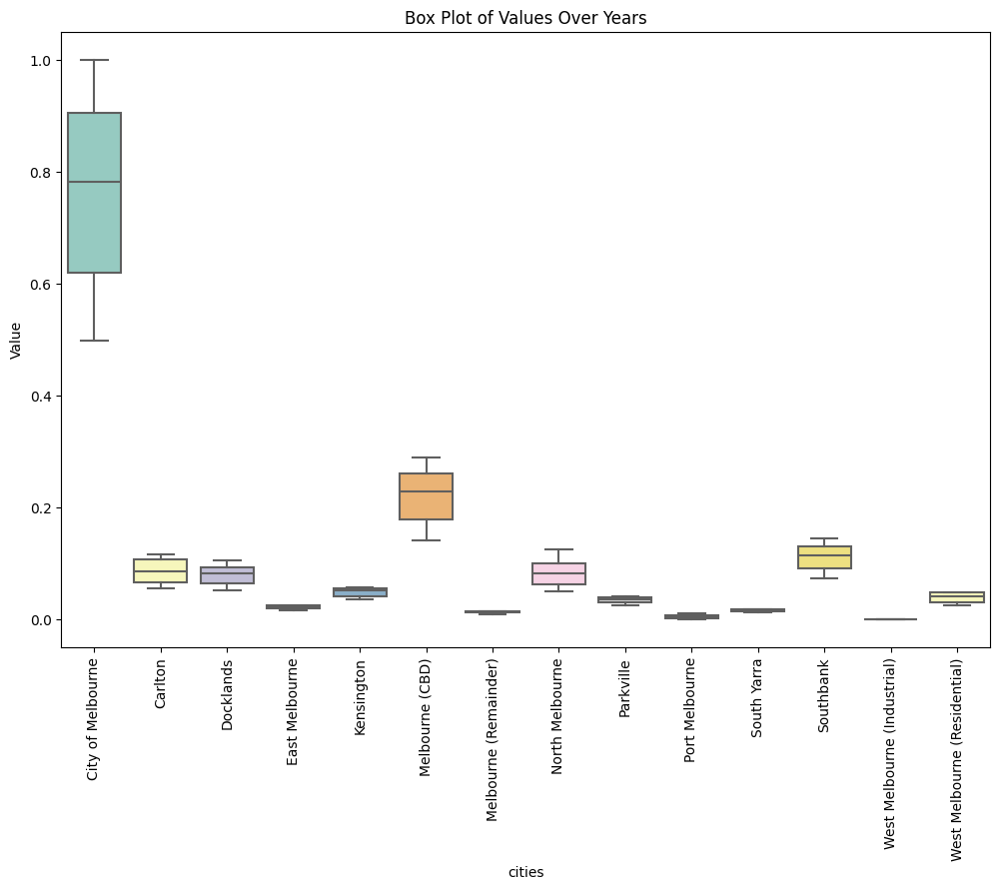

In [53]:
# Plotting box plot using seaborn
plt.figure(figsize=(12, 8))
sns.boxplot(data=pop, x='geography', y='value', palette='Set3')
plt.title('Box Plot of Values Over Years')
plt.xlabel('cities')
plt.xticks(rotation=90)
plt.ylabel('Value')
plt.show()

This box plot visualizes the distribution of population values over years for various locations within Melbourne. Here's what the graph tells us:

1. **Variability and Range**:
   - **City of Melbourne**: Shows a high median value close to 0.8 and a range extending from about 0.6 to 1.0, indicating a consistently high population with little variation over the years.
   - **Carlton**: Has a lower median population value, around 0.2, with very little variation.
   - **Docklands**: Similar to Carlton, shows minimal variation with a slightly lower median population value.
   
2. **Outliers and Consistency**:
   - No outliers are visible for any location, suggesting that population values are consistent within each area across the observed years.
   - Most locations except for the City of Melbourne have very compressed boxes, indicating that population values are stable and don’t fluctuate much.

3. **Comparisons**:
   - **Melbourne (CBD)** and **City of Melbourne** exhibit higher population values compared to the other regions, with Melbourne (CBD) having noticeable variability in its distribution.
   - Locations like **Southbank**, **West Melbourne (Industrial)**, and **West Melbourne (Residential)** have very low population values, close to 0, and show minimal variation, indicating stable but small populations.

4. **Interpretation for Planning**:
   - The high values and variability in the City of Melbourne and Melbourne (CBD) suggest these areas have not only high populations but also potentially dynamic changes in population density over time, likely needing more dynamic and robust urban planning and transportation solutions.
   - The stability in population values in areas like Carlton, Docklands, and others suggests that while population demands may be lower, planning can focus on maintaining or slowly developing existing infrastructure.

Overall, this box plot is particularly useful for understanding where population pressures are greatest and where they are most stable, assisting city planners and policymakers in making informed decisions about where to allocate resources and how to plan for future development or conservation.

<b>Tram dataset </b>
<ul>
    Initial visualization to see locations of tram stops 
</ul>

In [54]:
tram.head(3)

,stop_name,lat_tram,lon_tram
0,Market Street / Flinders Street,-37.819223,144.961401
1,Victoria Police Centre / Flinders Street,-37.821539,144.953569
2,Central Pier / Harbour Esplanade,-37.815427,144.945121


In [55]:
import folium

map = folium.Map(location = [tram["lat_tram"].iloc[0], tram["lon_tram"].iloc[0]], zoom_start=-1)

for i, rows in tram.iterrows():
    folium.Marker(location=[rows["lat_tram"], rows["lon_tram"]], tooltip=rows['stop_name']).add_to(map)

min_val = tram[['lat_tram', 'lon_tram']].min().values.tolist()
max_val = tram[['lat_tram', 'lon_tram']].max().values.tolist()

map.fit_bounds([min_val, max_val]) 


map

As the tram data is limited to the central square we will no longer use this dataset in our usecase 

<b>Metro station dataset </b>
<ul>
    Initial visualization to see locations of metro station stops 
</ul>

In [56]:
metro.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   station_name  219 non-null    object 
 1   lat_metro     219 non-null    float64
 2   lon_metro     219 non-null    float64
dtypes: float64(2), object(1)
memory usage: 5.3+ KB


In [57]:
map = folium.Map(location = [metro["lat_metro"].iloc[0], metro["lon_metro"].iloc[0]], zoom_start=10)

for i, rows in metro.iterrows():
    folium.Marker(location=[rows["lat_metro"], rows["lon_metro"]], tooltip=rows['station_name']).add_to(map)

min_val = metro[['lat_metro', 'lon_metro']].min().values.tolist()
max_val = metro[['lat_metro', 'lon_metro']].max().values.tolist()

map.fit_bounds([min_val, max_val]) 


map

In [58]:
bus.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309 entries, 0 to 308
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   lat_bus  309 non-null    float64
 1   lon_bus  309 non-null    float64
dtypes: float64(2)
memory usage: 5.0 KB


<b>Bus stop dataset </b>
<ul>
    Initial visualization to see locations of bus stops 
</ul>

In [59]:
map = folium.Map(location = [bus["lat_bus"].iloc[0], bus["lon_bus"].iloc[0]], zoom_start=10)

for i, rows in bus.iterrows():
    folium.Marker(location=[rows["lat_bus"], rows["lon_bus"]]).add_to(map)

min_val = bus[['lat_bus', 'lon_bus']].min().values.tolist()
max_val = bus[['lat_bus', 'lon_bus']].max().values.tolist()

map.fit_bounds([min_val, max_val]) 


map

As the data for Tram stops is not sufficient we will no longer use tram data 

In [60]:
# combining transport and popualtion map to visualize it on a single map
map = folium.Map(zoom_start=10) 

# to show the bus stops
for i, rows in bus.iterrows():
    folium.Marker(location=[rows["lat_bus"], rows["lon_bus"]],icon=folium.Icon(color='blue')).add_to(map)

# To show teh metro stops
for i, rows in metro.iterrows():
    folium.Marker(location=[rows["lat_metro"], rows["lon_metro"]], icon=folium.Icon(color='orange')).add_to(map)


for i, rows in pop_lat_long.iterrows():
    folium.Marker(location=[rows["city_lat"], rows["city_long"]], icon=folium.Icon(color='green')).add_to(map)



min_val = bus[['lat_bus', 'lon_bus']].min().values.tolist()
max_val = bus[['lat_bus', 'lon_bus']].max().values.tolist()

map.fit_bounds([min_val, max_val]) 


map

<h2><b>Part 2: Preprocessing </b></h2>
<p>Here we will further process the data to feed it into models and networks. Preprocessed data can significantly enhance the performance and accuracy of machine learning models. In the code bloc below we expand the population datset to show the population values for each city for each particular year. We also drop the "City of Melbourne" feature as it is not an actual city in the Small CLUE areas documentation. As we have already scaled and handled missing values previously we will not do that here. As there are no categorical variables we do not need encoding. Here we will also ensure the data is in the right format as many models require data to be in certain format </p>

<p>Preprocessing data so it can be fed into models and networks </p>

<h4> Population  </h4>

<p> Expanding the population datasets so that we can see the population for each year in particular city.  </p>

In [61]:
pop=pop.pivot_table(index="year", columns="geography", values="value", aggfunc='first')
# pop.head(5)

merging population column with the dataset that we previously worked on to find the latitude and longitudea of each geographic location so that the last two columns of population datasets reflect the lattitude and longitude of those locations/places 

In [62]:
pop.head(5)

geography,Carlton,City of Melbourne,Docklands,East Melbourne,Kensington,Melbourne (CBD),Melbourne (Remainder),North Melbourne,Parkville,Port Melbourne,South Yarra,Southbank,West Melbourne (Industrial),West Melbourne (Residential)
year,,,,,,,,,,,,,,
2021,0.055761,0.498634,0.051676,0.016120,0.035475,0.142201,0.010127,0.050790,0.025351,0.000032,0.012057,0.073296,0.0,0.025747
2022,0.057202,0.508040,0.052636,0.016519,0.036072,0.144739,0.010302,0.051715,0.025708,0.000032,0.012281,0.074626,0.0,0.026205
2023,0.057886,0.513070,0.053334,0.016694,0.036234,0.146416,0.010386,0.052030,0.025789,0.000032,0.012434,0.075551,0.0,0.026289
2024,0.060771,0.541296,0.057046,0.017697,0.037344,0.155845,0.010971,0.053701,0.026948,0.000036,0.013239,0.080619,0.0,0.027077
2025,0.065028,0.580116,0.061157,0.018923,0.039738,0.167209,0.011772,0.057585,0.028982,0.000039,0.014193,0.086469,0.0,0.029028


Dropping the "City of Melbourne" row as it not one of the locations in CLUE small area as seen here -
https://www.melbourne.vic.gov.au/sitecollectiondocuments/clue-small-area-block-map.pdf

In [63]:
pop=pop.drop(['City of Melbourne'],axis=1)

In [64]:
pop.head(5)

geography,Carlton,Docklands,East Melbourne,Kensington,Melbourne (CBD),Melbourne (Remainder),North Melbourne,Parkville,Port Melbourne,South Yarra,Southbank,West Melbourne (Industrial),West Melbourne (Residential)
year,,,,,,,,,,,,,
2021,0.055761,0.051676,0.016120,0.035475,0.142201,0.010127,0.050790,0.025351,0.000032,0.012057,0.073296,0.0,0.025747
2022,0.057202,0.052636,0.016519,0.036072,0.144739,0.010302,0.051715,0.025708,0.000032,0.012281,0.074626,0.0,0.026205
2023,0.057886,0.053334,0.016694,0.036234,0.146416,0.010386,0.052030,0.025789,0.000032,0.012434,0.075551,0.0,0.026289
2024,0.060771,0.057046,0.017697,0.037344,0.155845,0.010971,0.053701,0.026948,0.000036,0.013239,0.080619,0.0,0.027077
2025,0.065028,0.061157,0.018923,0.039738,0.167209,0.011772,0.057585,0.028982,0.000039,0.014193,0.086469,0.0,0.029028


In [65]:
new_pop = pop.copy()

In [66]:
pop.columns = pop.columns.astype(str)   # to change teh column names to type stirng 

In [67]:
pop=pop.reset_index()

In [68]:
# formatting the year column as datetime and setting it as index
pop.year = pd.to_datetime(pop.year, format="%Y")
pop.set_index('year', inplace =True)

In [69]:
pop=pop.loc[:, ['Carlton', 'Docklands', 'East Melbourne', 'Kensington','Melbourne (CBD)', 'Melbourne (Remainder)', 'North Melbourne', 'Parkville', 'Port Melbourne', 'South Yarra', 'Southbank','West Melbourne (Residential)']]

pop.head(3)

geography,Carlton,Docklands,East Melbourne,Kensington,Melbourne (CBD),Melbourne (Remainder),North Melbourne,Parkville,Port Melbourne,South Yarra,Southbank,West Melbourne (Residential)
year,,,,,,,,,,,,
2021-01-01,0.055761,0.051676,0.016120,0.035475,0.142201,0.010127,0.050790,0.025351,0.000032,0.012057,0.073296,0.025747
2022-01-01,0.057202,0.052636,0.016519,0.036072,0.144739,0.010302,0.051715,0.025708,0.000032,0.012281,0.074626,0.026205
2023-01-01,0.057886,0.053334,0.016694,0.036234,0.146416,0.010386,0.052030,0.025789,0.000032,0.012434,0.075551,0.026289


<h2>Models</h2>
<h3>Part A: Population Dataset</h3>

<h4> 1. ARIMA Model</h4>
<p> ARIMA models are used to handle time series data and it helps in predicting future values based on the past values. As we have yearly data about the population from year 2021 to 2041 for each city in Small Area CLUE population dataset, using ARIMA would be a good start to help use create a model that can predict the values for future years based on the current data. </p>
<ul>
    <li><b>AR (Auto Regression) - </b>This explains the relationship between the current observation and the lagged observation </li>
    <li><b>I (Integrated)- </b> In order to achieve a stationary series we apply differencing so that we dont have trends or seasionality. </li>
    <li><b>MA (Moving Average) - </b>This component helps us understand the relationship between an observation and the residual error from moving average model based on lagged observations. (Jason Brownlee 2017)</li>
</ul>

<p><b>General approach explained/shown below</b></p>

In [70]:
pop.head(5)

geography,Carlton,Docklands,East Melbourne,Kensington,Melbourne (CBD),Melbourne (Remainder),North Melbourne,Parkville,Port Melbourne,South Yarra,Southbank,West Melbourne (Residential)
year,,,,,,,,,,,,
2021-01-01,0.055761,0.051676,0.016120,0.035475,0.142201,0.010127,0.050790,0.025351,0.000032,0.012057,0.073296,0.025747
2022-01-01,0.057202,0.052636,0.016519,0.036072,0.144739,0.010302,0.051715,0.025708,0.000032,0.012281,0.074626,0.026205
2023-01-01,0.057886,0.053334,0.016694,0.036234,0.146416,0.010386,0.052030,0.025789,0.000032,0.012434,0.075551,0.026289
2024-01-01,0.060771,0.057046,0.017697,0.037344,0.155845,0.010971,0.053701,0.026948,0.000036,0.013239,0.080619,0.027077
2025-01-01,0.065028,0.061157,0.018923,0.039738,0.167209,0.011772,0.057585,0.028982,0.000039,0.014193,0.086469,0.029028


In [71]:
# first we choose one area in our dataset, lets say Carlton for simplicity 
data = pop.Carlton
data.head(5)

year
2021-01-01    0.055761
2022-01-01    0.057202
2023-01-01    0.057886
2024-01-01    0.060771
2025-01-01    0.065028
Name: Carlton, dtype: float64

<p>We check for stationarity here, as stationarity tells us if the data we are working on is stationary or not. A time series is stationary if all the statistical properties like mean, variance and correlation are constant over time. A stationary series does not have a trend or seasional effects and its fluctuation around the mean is constant. 
    
The stationarity is checked for model accuracy as most time series forecasting methods assume that our models are stationary. Moreover stationary data is easy to model and predictions made on such a model are reliable as the future values have the same mean and variance as past values.  (Duke University 2024)</p>

In [72]:
# Checking for stationarity 
result = adfuller(data.dropna())
print(f"ADF Statistics: {result[0]}")
print(f"p-value:{result[1]}")

ADF Statistics: -2.5131706971973995
p-value:0.11230255104868042


<p>ADF test tells us the ADF statistics and p-value. The Augmented Dickey-Fuller Test, tests for unit root in time series which indicated the data is non-stationary and hence is affected by trends. 

Null Hypothesis: The series has unit root or it is non-stationary
Alternative Hypothesis: The series has no unit root or it is stationary

As our p-value (0.1123) is not below 0.05 we cannot reject null hypthesis and this means that our data is not stationary and hence we will make it stationary in following lines of codes below. 

The ADF statistics suggest that the higher the negative value, the stronger the evidence to not reject null hypothesis, as seen above we have a negative value hence proving strongly that we cannot reject the null hypothsis. </p>

In [73]:
# applying differencing
data = data.diff().dropna()

diff_results = adfuller(data)
print(f"ADF Statistics: {diff_results[0]}")
print(f"p-value:{diff_results[1]}")

ADF Statistics: -1.302036050028587
p-value:0.6282403042610456


<p>Now the data is staionary as the p-value is below 0.05</p>

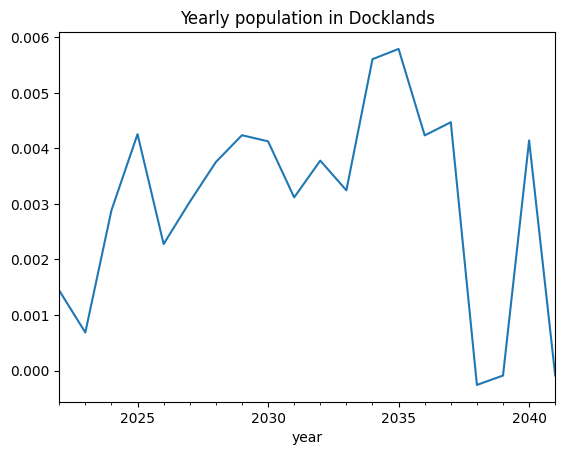

In [74]:
data.plot()
plt.title('Yearly population in Docklands')
plt.show()

2042-01-01    0.001606
2043-01-01    0.001054
2044-01-01    0.001233
2045-01-01    0.001175
2046-01-01    0.001194
Freq: AS-JAN, Name: predicted_mean, dtype: float64


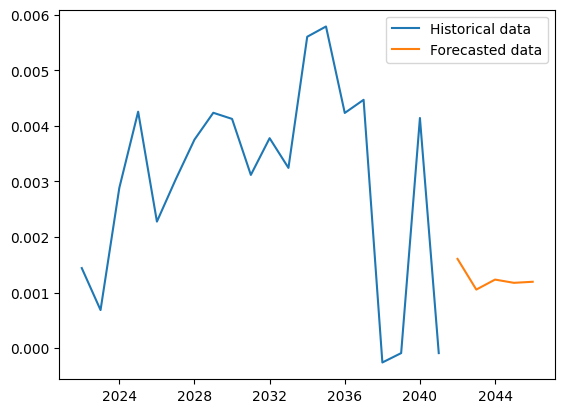

In [75]:
# defining the ARIMA model 
model =ARIMA(data,order=(1,1,1))

# fitting
fitted = model.fit()

# forecasting 
forecast = fitted.forecast(steps=5)
print(forecast)

# plot 
plt.plot(data.index, data,label="Historical data")
plt.plot(forecast.index, forecast, label="Forecasted data")
plt.legend()
plt.show()

<p><b>Main function that perform ARIMA on all cities and plots the result</b></p>

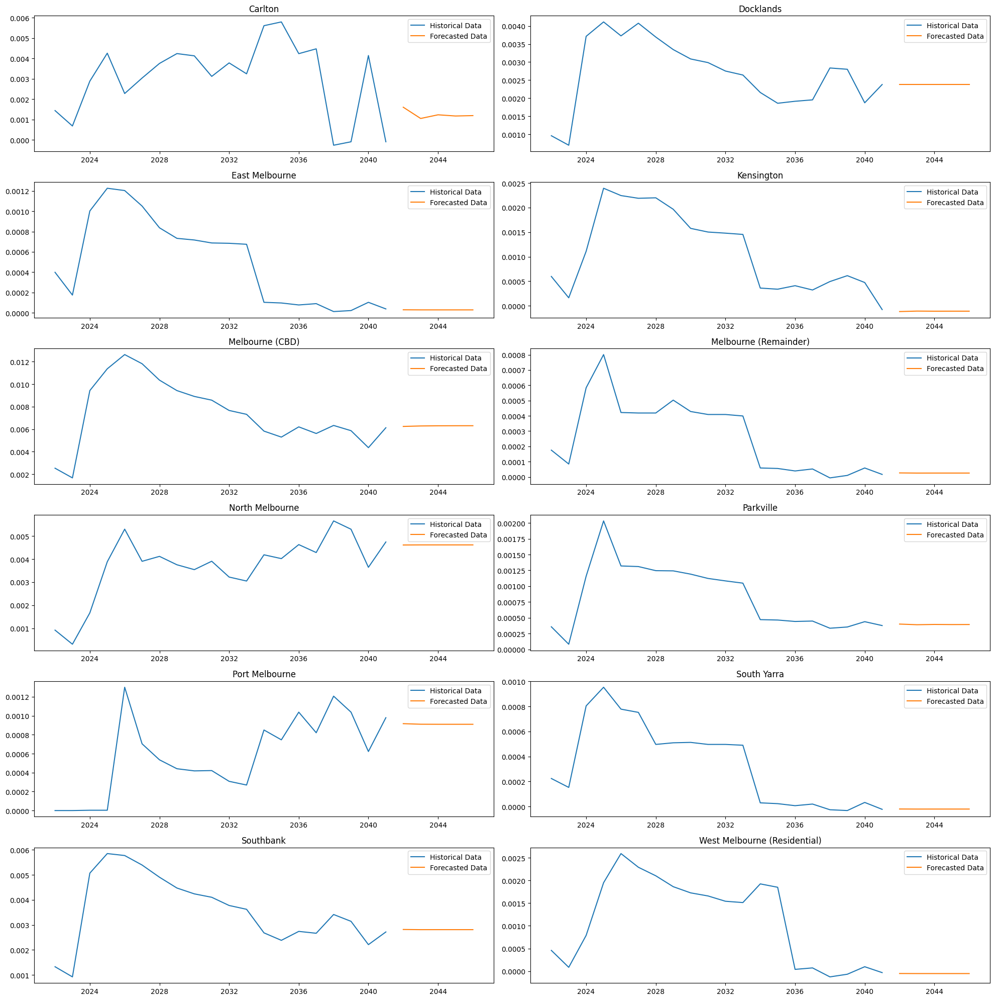

In [76]:
# All functions 

def plot(data, forecast, city_name):
    fig, axs = plt.subplots(6, 2, figsize=(20, 20))
    
    for i in range(12):
        row = i // 2  # row index
        col = i % 2   # column index
    
        axs[row, col].plot(new_data[i].index, new_data[i], label="Historical Data")
        axs[row, col].plot(new_forecast[i].index, new_forecast[i], label="Forecasted Data")
        axs[row, col].set_title(new_city_name[i])
        axs[row, col].legend()  
    plt.tight_layout()
    plt.show()

        
    

def model_arima(data):
    # defining the ARIMA model 
    model =ARIMA(data,order=(1,1,1))
    
    # fitting
    fitted = model.fit()
    
    # forecasting 
    forecast = fitted.forecast(steps=5)
    # print(forecast)
    return (data, forecast)




def main():  
    colname = pop.columns

    # empty lists to use later
    dict_adf_and_p = {}  # self explanatory 
    new_data_list = [] 
    forecast_list = []
    city_name_list = []
    
    for i in range(pop.shape[1]):
        data = pop.iloc[:, i]
        city_name = colname[i]
        city_name_list.append(city_name)
        # print(city_name)
        result = adfuller(data)
        adf = result[0]
        p = result[1]

        # if the p values is > 0.05 we make the stationarize it using diff() or else both diff to stationarize and log to transoform to see hideen patterns in data 
        if p > 0.05:
            data = data.diff().dropna()
            results = adfuller(data)
            adf = result[0]
            p = result[1]
            dict_adf_and_p[city_name] = [adf,p]
        else:
            data = data.diff().dropna()
            data = np.log(data + 1)
            results = adfuller(data)
            adf = result[0]
            p = result[1]
            dict_adf_and_p[city_name] = [adf,p]
                         
            
        new_data, forecast = model_arima(data)
        new_data_list.append(new_data)
        forecast_list.append(forecast)
    return new_data_list,forecast_list, city_name_list 



new_data, new_forecast, new_city_name = main()  
plot(new_data, new_forecast, new_city_name)




<p><b>Key findings from the plot. </b></p>
<ul>
    <li><b>1. Historical Data Trends:</b> Most areas show some level of fluctuations in the populations from the year 2021 to 2041 (historical data). Areas like Carlton, East Melbourne and Port Melbourne show significant changes over the years while others like Docklands, Melbourne CBD and Southbank show gradual decrease in population in coming years. We can see a general decline in population in cities like South Yarra, West Melbourne (Residential), Parkville, Melbourne(Remainder) and East Melbourne. Cities like Carlton, North Melbourne and Port Melbourne have complex changes in population as it decreases and then increases in following years. </li><br>
    <li><b>2. Forecasted Data:</b> For most areas the forecasted data sees no significant change in population from the historical point. This might indicate that the recent trends are a good indication of future trends with no significant changes.  </li>
</ul>

<h4> 2. Linear Regression</h4>
<p> Linear Regression on population dataset will allow us to understand the population growth in different geographic areas. We expect the growth to be a linear trend in over time over time as long as there isnt drastic demographic shifts. Through linear regression we will be able to estimate the rate of population increase and decrease in various cities as a function of time. This will help us gain more insights on top of the results achieved previously through ARIMA model. To understand how well our training set is performing against the new test data we use metrics like Mean squared Error (MSE) and R-squared.  MSE meaasures the average squared difference between the actual observed values and the values predicted by the model. Lower MSE indicates that the model's predictions are closer to the actual data points and hence the model will show better fit for the unknown newer data. R-squared is a statistical measure that represents the proportion of the variance in teh dependent variable that is predicted from the independent variable  </p>

<p><b>General approach explained/shown below</b></p>

In [77]:
new_pop = new_pop.reset_index()  # so that year is not index and an actual additional column

In [78]:
# preparing the data to be put into the model
x = new_pop.year.values.reshape(-1,1)
y = new_pop.Carlton.values.reshape(-1,1)

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.30, random_state=42)

In [79]:
model = LinearRegression()
model.fit(x_train,y_train)

LinearRegression()

In [80]:
x_test

array([[2021],
       [2038],
       [2036],
       [2022],
       [2029],
       [2026],
       [2032]], dtype=int64)

In [81]:
y_pred = model.predict(x_test)
y_pred

array([[0.05087344],
       [0.11051176],
       [0.10349549],
       [0.05438158],
       [0.07893853],
       [0.06841412],
       [0.08946294]])

In [82]:
y_test

array([[0.05576106],
       [0.11245011],
       [0.10823842],
       [0.05720173],
       [0.07833479],
       [0.06730588],
       [0.08936046]])

In [83]:
mse = mean_squared_error(y_test, y_pred)
print(f"MSE is {mse}")
r2 = r2_score(y_test, y_pred)
print(f"R^2 score is {r2}")

MSE is 8.528268545329554e-06
R^2 score is 0.9813359132611165


In [84]:
future_years = np.array(np.arange(2041, 2048)).reshape(-1, 1)
future_years

array([[2041],
       [2042],
       [2043],
       [2044],
       [2045],
       [2046],
       [2047]])

In [85]:
future_pred = model.predict(future_years)
future_pred

array([[0.12103617],
       [0.1245443 ],
       [0.12805244],
       [0.13156057],
       [0.13506871],
       [0.13857685],
       [0.14208498]])

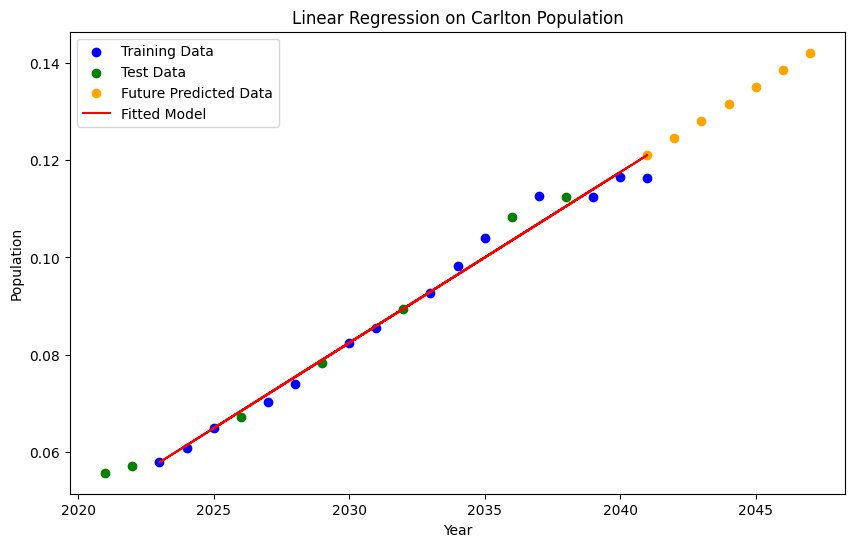

In [86]:
plt.figure(figsize=(10, 6))
plt.scatter(x_train, y_train, color='blue', label='Training Data')
plt.scatter(x_test, y_test, color='green', label='Test Data')
plt.scatter(future_years, future_pred, color='orange', label='Future Predicted Data')
plt.plot(x_train, model.predict(x_train), color='red', label='Fitted Model')
plt.title('Linear Regression on Carlton Population')
plt.xlabel('Year')
plt.ylabel('Population')
plt.legend()
plt.show()

<p><b>Code that goes through all cities</b></p>

In [87]:
new_pop = new_pop.drop(columns="West Melbourne (Industrial)")  # as most data points are 0

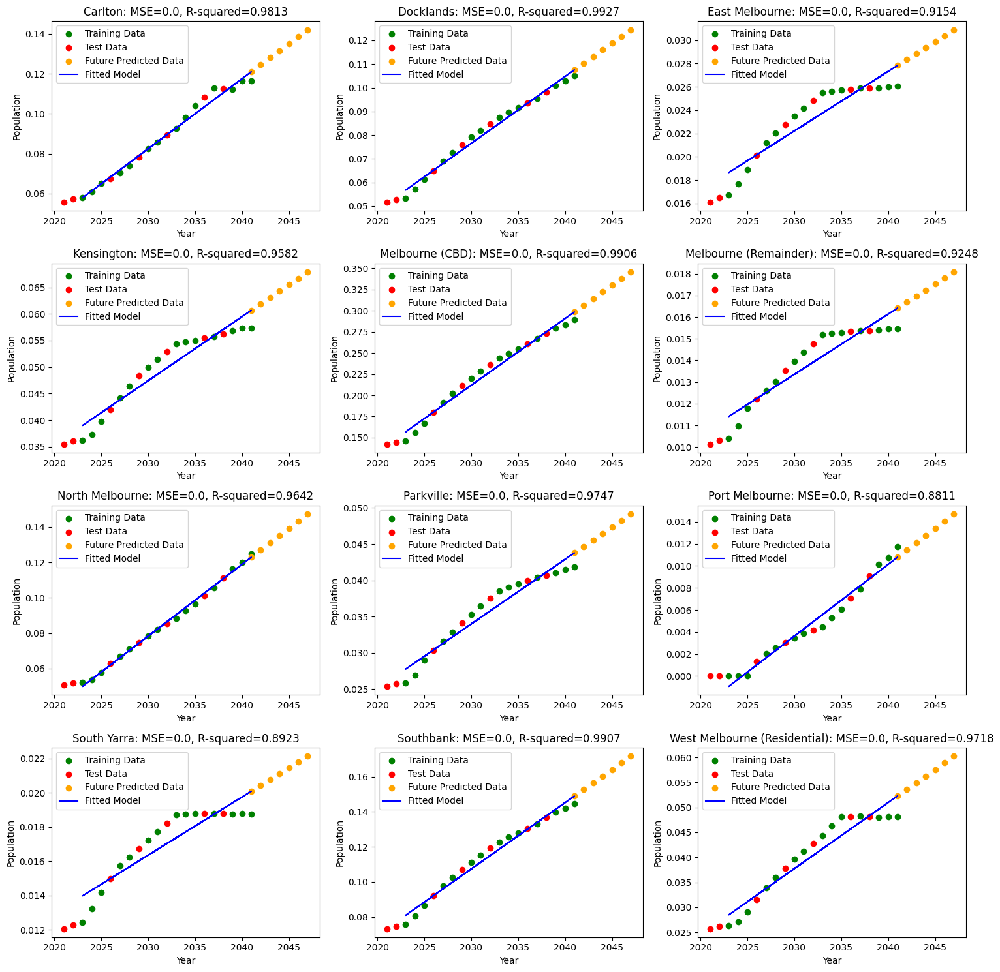

In [88]:
city_names = list(new_pop.columns[1:])  # List of city names, excluding 'year'
metric_dict = {}
num_cities = len(city_names)

# for visualization 
cols = 3  # Number of columns in subplot grid
rows = (num_cities + cols - 1) // cols  # Calculate required number of rows

fig, axs = plt.subplots(rows, cols, figsize=(15, 15)) 
axs = axs.flatten()  # Flatten the axis array for easier indexing

for i, city in enumerate(city_names):
    data = new_pop.loc[:, ['year', city]]
    x = data['year'].values.reshape(-1, 1)
    y = data[city].values.reshape(-1, 1)

    # Split the data, 70 - 30 split
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

    # Fit the model
    model = LinearRegression()
    model.fit(x_train, y_train)

    # Predict
    y_pred = model.predict(x_test)
    fit_line = model.predict(x_train)

    # Metrics
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    metric_dict[city] = (mse, r2)

    # Future predictions
    future_years = np.array(np.arange(2041, 2048)).reshape(-1, 1)
    future_pred = model.predict(future_years)

    # Plotting in subplot
    ax = axs[i]
    ax.scatter(x_train, y_train, color='green', label='Training Data')
    ax.scatter(x_test, y_test, color='red', label='Test Data')
    ax.scatter(future_years, future_pred, color='orange', label='Future Predicted Data')
    ax.plot(x_train, fit_line, color='blue', label='Fitted Model')
    ax.set_title(f'{city}: MSE={round(mse,4)}, R-squared={round(r2,4)}')
    ax.set_xlabel('Year')
    ax.set_ylabel('Population')
    ax.legend()

# Disable unused subplots if number of cities is not a perfect multiple of cols*rows
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

fig.tight_layout()  # Adjust layout to prevent overlap
plt.show()

<p><b>Key findings from the plot. </b></p>
<ul>
    <li><b>1.Model Accuracy:</b>The R-squared value accross all areas in the linear model shows a strong predictive power regarding how population will change with years. Most scatterpoints show a strong positive linear relationship.   </li><br>
    <li><b>2.MSE:</b>Most areas show 0 MSE values which suggest that there are little to no errors in between teh predicted and the actual values of the test set.  </li><br>
    <li><b>3. Model Fit:</b>Looking at the line of fit, it looks like there is good alignment between fitted model and both training and test data and future predictions. This shows that the model is well tuned to the historical trends and can reasonably provide accurate forecasts. </li><br>
    <li><b>4. Overall Trend:</b>All the areas show consistent increase in the population over time as the plot indicates the positive slope.  </li>
    
</ul>

<h3>Part B: Bus Stations Dataset</h3>

<h4> 1. DBSCAN (Density Based Spatial Clustering)   </h4>
<ul>
    <li> <b>Goal: </b>To identify clusters of existing bus stops. This helps in understanding how the bus stops are currently distributed. 
</li>
    <li><b>Benefits: </b>By understanding the overall distribution of the current bus stops we can located potential areas where new bus stops can be established.  </li>
</ul>

<p><b>General approach explained/shown below</b></p>

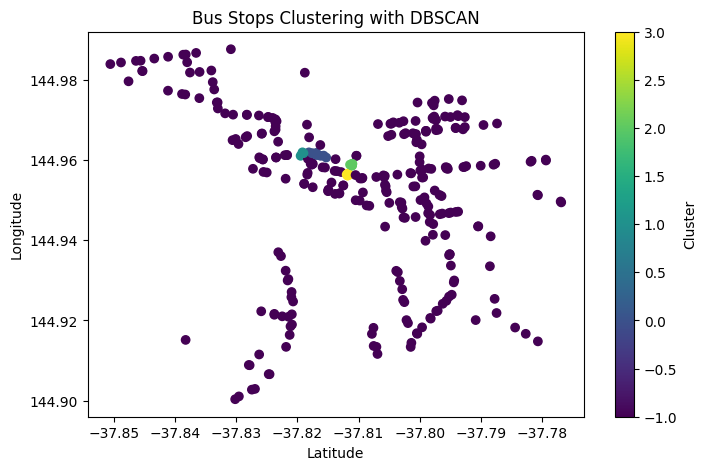

In [89]:
# fit the model
# eps is typically set by considering the geographical scale so (e.g., 0.001 for roughly 100 meters)
# initial random parameter values set by me.
dbscan = DBSCAN(eps=0.001, min_samples=5)
bus['cluster'] = dbscan.fit_predict(bus[['lat_bus', 'lon_bus']])

# visualize
plt.figure(figsize=(8, 5))
plt.scatter(bus['lat_bus'], bus['lon_bus'], c=bus['cluster'], cmap='viridis', marker='o', label='Bus Stops')
plt.title('Bus Stops Clustering with DBSCAN')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.colorbar(label='Cluster')
plt.show()

In [90]:
bus.cluster.value_counts()

-1    284
 0      9
 3      6
 1      5
 2      5
Name: cluster, dtype: int64

In [91]:
# pip install geopandas

<p><b>Using Gridsearch to look for optimal parameter(eps, min_samples) values</b> </p>

In [92]:
lat_long = bus[["lat_bus", "lon_bus"]]
X = lat_long.to_numpy()

In [93]:
# implementing grid search 
# epsilons to try 
epsilons = np.linspace(0.001, 0.01, num=20)

# min_samples to try
min_samples = np.arange(2,20, step = 3)


# to get combiantions of (eps, mmin_samples)
import itertools
all_combinations = list(itertools.product(epsilons, min_samples))
# all_combinations

In [94]:
iteration_num = len(all_combinations) 

In [95]:
def score_and_labels(all_combinations, X):
    all_scores = [] 
    all_labels_list = [] 

    # to perfrom dbscan on all possible operations by using for loop to go through each combination iteratively
    for i, (eps, num_samples) in enumerate (all_combinations):
        dbscan_model= DBSCAN(eps=eps, min_samples=num_samples)
        dbscan_model.fit_predict(X)
        labels = dbscan_model.labels_
        unique_labels = set(labels)
        num_clusters = len(unique_labels)
        
        # cluster size of less than 2 does not give any isngihts and above 80 are too cluttered , score of -1 is bad
        if(num_clusters < 2) or (num_clusters > 50):
            all_scores.append(-1000) # ignore this score 
            all_labels_list.append("Ignore")  # ignore this label 
            print(f"Ignored:    {eps, num_samples, num_clusters} .... {i} out of total {iteration_num} iterations")
            continue

        all_scores.append(ss(X, labels))
        all_labels_list.append(labels)


        print(f"Index: {i}, Score: {all_scores[-1]}, NumClusters: {len(unique_labels)}")

    # optimal values  
    opt_index = np.argmax(all_scores)   # gives index of - highest score out of all scores 
    opt_combination = all_combinations[opt_index]  # the combination taht gives teh best score 
    opt_labels = all_labels_list[opt_index]  # the labels associated to the best score & combinations
    opt_score = all_scores[opt_index]    # The best score itself. 


    return {'optimal epsilon': opt_combination[0],
            'optimal min samples' : opt_combination[1], 
            'optimal labels' : opt_labels,
            'optimal score': opt_score }
            
        
        
optimal_values = score_and_labels(all_combinations, X)


Ignored:    (0.001, 2, 89) .... 0 out of total 120 iterations
Index: 1, Score: -0.32403442946572886, NumClusters: 5
Ignored:    (0.001, 8, 1) .... 2 out of total 120 iterations
Ignored:    (0.001, 11, 1) .... 3 out of total 120 iterations
Ignored:    (0.001, 14, 1) .... 4 out of total 120 iterations
Ignored:    (0.001, 17, 1) .... 5 out of total 120 iterations
Ignored:    (0.0014736842105263158, 2, 78) .... 6 out of total 120 iterations
Index: 7, Score: -0.32546918908174677, NumClusters: 10
Index: 8, Score: -0.29899917409098287, NumClusters: 3
Ignored:    (0.0014736842105263158, 11, 1) .... 9 out of total 120 iterations
Ignored:    (0.0014736842105263158, 14, 1) .... 10 out of total 120 iterations
Ignored:    (0.0014736842105263158, 17, 1) .... 11 out of total 120 iterations
Ignored:    (0.0019473684210526317, 2, 66) .... 12 out of total 120 iterations
Index: 13, Score: -0.19808233205389708, NumClusters: 15
Index: 14, Score: -0.3038991133496785, NumClusters: 6
Index: 15, Score: -0.1931

In [96]:
optimal_values

{'optimal epsilon': 0.0076315789473684215,
 'optimal min samples': 11,
 'optimal labels': array([ 1,  0,  0,  0,  0,  1,  0,  2,  0,  0,  0,  0,  1,  0,  0,  0,  1,
         0,  0,  0,  0,  0,  0,  0,  1,  1,  0,  0,  2,  0,  0,  0,  0,  0,
         0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  1,  0, -1,  0,  2,  0,
         0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0, -1,  0,  1,  0,
         0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  0,  0,  0,  0,  0,
         2,  0,  1,  1,  0,  0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0, -1,
         0,  1,  0,  0,  0,  0,  0, -1,  0, -1,  0,  0,  1,  0,  0,  0,  0,
         1,  0,  0,  0,  0,  0,  1,  0,  0,  0,  2,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  1,  0,  0,  0,  1,  0,  1,  0,  0,  0,  0,  0,  2,  0,
        -1,  0,  2,  0,  2,  0, -1,  0,  0,  0,  0, -1,  0, -1, -1,  1,  0,
         0,  0, -1,  1,  0,  0,  0,  0,  0, -1,  0,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  2,  0,  0,  1,  1,  0,  0,  0,  0,  0,

In [97]:
dbscan = DBSCAN(eps=0.007, min_samples=11)
bus['cluster'] = dbscan.fit_predict(bus[['lat_bus', 'lon_bus']])

In [98]:
bus.cluster.value_counts()

 0    232
-1     31
 1     30
 2     16
Name: cluster, dtype: int64

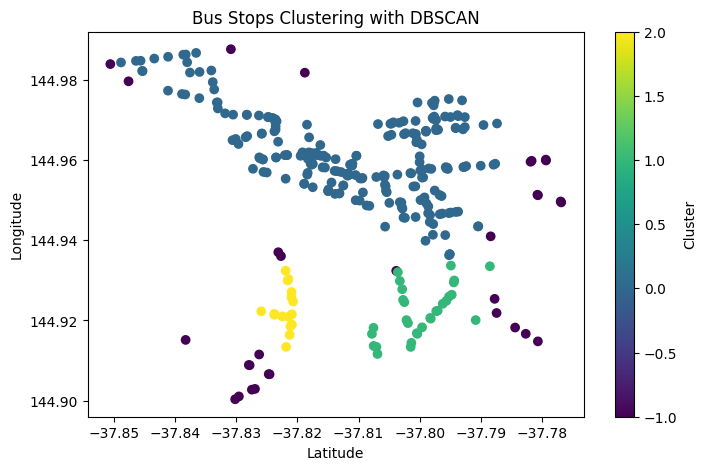

In [99]:
# visualize
plt.figure(figsize=(8, 5))
plt.scatter(bus['lat_bus'], bus['lon_bus'], c=bus['cluster'], cmap='viridis', marker='o', label='Bus Stops')
plt.title('Bus Stops Clustering with DBSCAN')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.colorbar(label='Cluster')
plt.show()

In [100]:
# coordinates ofunderserved areas 
underserved_bus = bus[bus.cluster.isin([-1,2])]
underserved_bus.reset_index(drop=True, inplace=True)


In [101]:
# visualization to show the locatin of underserved bus stops with red marker
m = folium.Map(location=[bus['lat_bus'].mean(), bus['lon_bus'].mean()], zoom_start=13)

# Add bus stops to the map
for idx, row in bus.iterrows():
    folium.CircleMarker(
        location=[row['lat_bus'], row['lon_bus']],
        radius=5,
        color='green',
        fill=True,
        fill_color='blue'
    ).add_to(m)

# Display the map
# m.save('Bus_Stops_Map.html')
for i, rows in underserved_bus.iterrows():
    folium.Marker(location=[rows["lat_bus"], rows["lon_bus"]], icon=folium.Icon(color='red')).add_to(m)

m


<p><b>Key findings from the plot. </b></p>
<p>The plot above shows the clusters of bus stops with different colours and later on real world map. This is helpful in understanding how the bus stops are distributed within the city and potenatial areas of interest for future development. </p>
<ul>
    <li><b>1.Distribution:</b>As the bus stops are grouped into distinct clusters we can see how bus stops are geopgraphically close to each other. The largest cluster (blue) is more spread out which indicates a heavy traffic area where bus stops are densely populated.   </li><br>
    <li><b>2.Underserved Areas:</b> The smaller clusters (yellow, green and purple) indicate the areas with fewer bus stops where new bus stops can be establisehd in future to expand the bus line and improve the transportation service.   </li><br>
    <li><b>3.Isolated bus stops (outliers):</b> The bus stops indicated in purple or yellow are isolated from the central bus stops. These bus stops might serve certain localities however they can be evaluated to see if more bus stops are needed in such areas.  These bus stops are also indiacated using red location markers on the real world map</li><br>
    <li><b>4.Planning and optimization:</b>This clustering result can be used to plan routes and optimization of transport services. By loooking at the densely populated clusters, urban planners can design bus stop routes that connect these densely populated areas efficiently, perhaps by adding new stops in underserved areas to ensure adequate service to the local population.   </li>
    
</ul>

<h4> 2. Haversine Formula to find distance</h4>
<ul>
    <li> <b>1. Geographic Distance Calculation: </b> Haversine formule helps in finding the distance between two locations on earth assuming we have the latitude and longitude for the locations between which we want to apply the formula on. By understanding which stops are near to each other we can find out the bus stops that are isolated and areas that are in dire need of transportation services for the locals. 
</li><br>
    <li> <b>2. Short distance calculation: </b> For transportation projects involving bus stops and metro stations, accurate distance calculations are crucial for efficient routing and scheduling. The Haversine formula is especially good for this purpose as it provides a high level of accuracy for relatively short distances, which are typical in urban environments 
</li><br>
    <li><b>3. Benefits: </b><br>
        <p><b>Accessibility Analysis:</b> Understanding how far stops are from one another can help assess the accessibility of public transportation for residents. Areas poorly served can be identified and addressed. </p>
        <p><b>Service Frequency Adjustments:</b> Distance data can be used to help determine where to increase service frequencies or capacities, particularly in rapidly growing or heavily trafficked areas.</p>
    </li>
        
    
</ul>

In [102]:
# a function taht calculates the distance beween each pair of points 
import haversine as hs
from geopy.distance import geodesic
def calculate_distances(df):
    n = len(df)
    distance_matrix = np.zeros((n, n))  #empty matrix
    hv_matrix = np.zeros((n,n))
    for i in range(n):
        for j in range(i + 1, n):  # Loop over each pair once
            point1 = (df.loc[i, 'lat_bus'], df.loc[i, 'lon_bus'])
            point2 = (df.loc[j, 'lat_bus'], df.loc[j, 'lon_bus'])
            
            distance = geodesic(point1, point2).kilometers  # Distance in kilometers
            distance_matrix[i, j] = distance
            distance_matrix[j, i] = distance  # Symmetric matrix

            # harvesine distance
            hs_distance = hs.haversine(point1,point2)
            hv_matrix[i,j] = hs_distance
            hv_matrix[j,i] = hs_distance 

            
    return distance_matrix, hv_matrix

# Calculate the distance matrix for underserved metro stations
dist_matrix, hv_matrix = calculate_distances(underserved_bus)

# Calculate the distance matrix for all metro stations 
dist_matrix_all_bus, hv_matrix_all_bus = calculate_distances(bus)

#  convert to a DataFrame for nicer display
underserved_distance_df = pd.DataFrame(dist_matrix, index=underserved_bus.index, columns=underserved_bus.index)

In [103]:
underserved_distance_df

,0,1,2,3,4,5,6,7,8,9,...,37,38,39,40,41,42,43,44,45,46
0,0.000000,1.964545,2.605692,3.652704,6.895595,2.115379,1.873523,1.980960,3.647904,2.177803,...,3.447816,3.699037,2.404622,1.953986,3.232718,3.349753,1.988170,3.642521,3.242434,2.121221
1,1.964545,0.000000,0.862403,5.357905,5.725009,0.523640,3.787898,0.032375,2.488723,0.619123,...,5.122267,2.518697,0.805197,0.288873,2.119326,5.228514,0.400413,5.351613,2.119995,0.776542
2,2.605692,0.862403,0.000000,6.146014,6.084751,1.265593,4.476681,0.830551,1.709769,1.335583,...,5.917246,1.730613,0.244921,0.695853,1.392195,5.945374,0.629202,6.138600,1.388683,0.559538
3,3.652704,5.357905,6.146014,0.000000,8.173400,5.251295,1.961359,5.384167,7.297522,5.262132,...,0.258265,7.349403,5.978949,5.452847,6.883566,0.981970,5.517946,0.019532,6.893570,5.726557
4,6.895595,5.725009,6.084751,8.173400,0.000000,5.234256,7.869994,5.741710,7.606925,5.136704,...,7.932268,7.603056,6.245052,5.992522,7.404850,8.725853,6.085721,8.181785,7.397035,6.410958
5,2.115379,0.523640,1.265593,5.251295,5.234256,0.000000,3.828361,0.548972,2.957687,0.098221,...,5.006380,2.983183,1.275673,0.812217,2.605959,5.218645,0.922308,5.246818,2.605329,1.295189
6,1.873523,3.787898,4.476681,1.961359,7.869994,3.828361,0.000000,3.808405,5.434710,3.867979,...,1.819885,5.488969,4.278065,3.812646,5.028177,1.481333,3.854608,1.946689,5.039425,3.993454
7,1.980960,0.032375,0.830551,5.384167,5.741710,0.548972,3.808405,0.000000,2.456910,0.643576,...,5.148906,2.486769,0.773025,0.263506,2.088139,5.250875,0.373512,5.377809,2.088744,0.748495
8,3.647904,2.488723,1.709769,7.297522,7.606925,2.957687,5.434710,2.456910,0.000000,3.034830,...,7.095550,0.058454,1.686901,2.232070,0.417102,6.905076,2.122394,7.286840,0.408922,1.771010
9,2.177803,0.619123,1.335583,5.262132,5.136704,0.098221,3.867979,0.643576,3.034830,0.000000,...,5.015702,3.059245,1.357261,0.907073,2.687763,5.247484,1.016249,5.258009,2.686810,1.387397


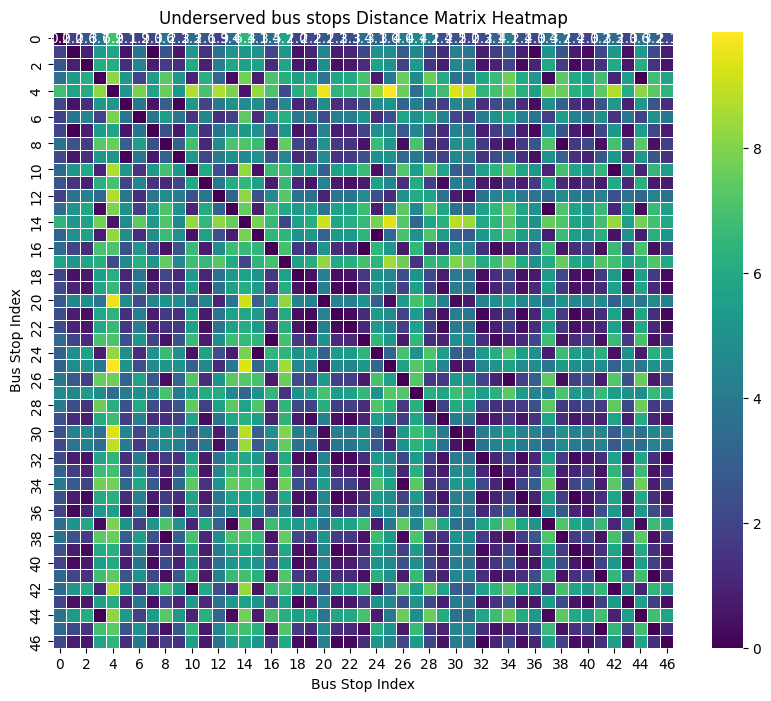

In [104]:
plt.figure(figsize=(10, 8))  # Set the figure size for the heatmap
sns.heatmap(underserved_distance_df, annot=True, fmt=".1f", cmap='viridis', linewidths=.5)
plt.title('Underserved bus stops Distance Matrix Heatmap')
plt.xlabel('Bus Stop Index')
plt.ylabel('Bus Stop Index')
plt.show()

This heatmap displays a distance matrix for underserved bus stops, where each cell represents the distance between pairs of bus stops, indexed from 0 to about 46. The colors indicate the magnitude of the distance, with darker colors (closer to blue and purple) indicating shorter distances and lighter colors (towards yellow) indicating greater distances. Here's what the heatmap tells us:

1. **Close Proximity Patterns**: The clusters of darker colors (blues and purples) suggest that certain bus stops are located very close to each other. This could be indicative of densely populated areas or regions where stops are closely spaced.

2. **Distance Variation**: There are sporadic patches of lighter colors (yellows and greens), indicating longer distances between certain bus stops. This variation can signal areas where service might be less frequent or accessible, potentially indicating regions that are underserved and might benefit from additional stops or enhanced services.

3. **Diagonal Line of Darkness**: The diagonal from the top left to the bottom right, which is uniformly dark, represents the distance from each bus stop to itself, which is naturally zero. This is a standard feature in distance matrices.

4. **Identifying Potential Service Gaps**: The areas with lighter squares between darker clusters could be key locations for adding new bus stops or improving transit connectivity. These gaps in service might represent physical barriers (like rivers or highways) or simply areas that have been overlooked in transit planning.

5. **Strategic Planning**: Planners can use this information to optimize routes, considering where to place new stops or how to reroute existing lines to reduce overall travel times and improve service coverage in underserved areas.

Overall, this heatmap provides a visual tool for identifying how evenly distributed and accessible bus transportation services are across a region, highlighting both well-served areas and potential gaps in service.

In [105]:
hv_matrix

array([[0.        , 1.96805163, 2.60916272, ..., 3.64238885, 3.24166173,
        2.12327712],
       [1.96805163, 0.        , 0.86153687, ..., 5.35604021, 2.1152105 ,
        0.77471909],
       [2.60916272, 0.86153687, 0.        , ..., 6.14227934, 1.38544026,
        0.56052366],
       ...,
       [3.64238885, 5.35604021, 6.14227934, ..., 0.        , 6.88213191,
        5.7200672 ],
       [3.24166173, 2.1152105 , 1.38544026, ..., 6.88213191, 0.        ,
        1.37830287],
       [2.12327712, 0.77471909, 0.56052366, ..., 5.7200672 , 1.37830287,
        0.        ]])

In [106]:
bus_map = folium.Map(location=[underserved_bus['lat_bus'].mean(), underserved_bus['lon_bus'].mean()], zoom_start=13)

# Threshold distance (e.g., 5 kilometers)
threshold = 7
df = underserved_bus
for i in range(len(df)):
    for j in range(len(df)):
        if i != j and pd.DataFrame(hv_matrix).iloc[i, j] >= threshold:
            folium.PolyLine(
                locations=[(df.iloc[i]['lat_bus'], df.iloc[i]['lon_bus']), 
                           (df.iloc[j]['lat_bus'], df.iloc[j]['lon_bus'])],
                color='violet',
                weight=4,
                tooltip=f'{pd.DataFrame(hv_matrix).iloc[i, j]:.2f} km'
            ).add_to(bus_map)

            

# Add bus stops to the map
for idx, row in bus.iterrows():
    folium.CircleMarker(
        location=[row['lat_bus'], row['lon_bus']],
        radius=5,
        color='purple',
        fill=True,
        fill_color='black'
    ).add_to(bus_map)

# Display the map
# m.save('metro.html')
for i, rows in underserved_bus.iterrows():
    folium.Marker(location=[rows["lat_bus"], rows["lon_bus"]], icon=folium.Icon(color='red')).add_to(bus_map)

            
bus_map

Based on the map visualization showing bus stop distribution with red markers for underserved stops and purple markers for other stops, and considering the violet lines representing distances greater than 7 kilometers between bus stops, we can deduce several important pieces of information about current bus stop distribution and potential locations for new stops:

1. **High Concentration Areas**: The central area, particularly around the Melbourne CBD, has a high concentration of bus stops, both underserved (red) and otherwise (purple). This suggests a well-serviced urban core which might not require additional stops but could benefit from other types of service improvements such as increased frequency or extended hours.

2. **Long Distance Between Stops**: The violet lines, indicating distances greater than 7 kilometers between certain stops, show significant gaps in service coverage. These lines, especially those stretching out to areas with fewer or no stops, highlight regions where new stops could dramatically improve service.

3. **Identifying Underserved Regions**: The red markers signify underserved bus stops, potentially due to their isolation from other stops or because they serve areas with insufficient coverage. Placing new stops between these red-marked underserved stops and the nearest purple stops could enhance connectivity.

4. **Spatial Distribution of Service Gaps**: The distribution of violet lines shows not just linear distances but also the geographic spread of areas lacking adequate service. The southern and eastern peripheries of the map, for instance, show longer distances between stops, suggesting that these are likely areas where public transit accessibility could be improved.

5. **Strategic Placement for New Stops**: The areas without any markers or with sparse coverage by purple markers are potential zones for developing new bus stops. Strategic placement in these zones can help bridge the long gaps shown by the violet lines, ensuring a more evenly distributed transit network that can cater to a larger population and reduce transit deserts.

6. **Optimization Opportunities**: Analyzing the overlap of long-distance lines and existing bus stops can offer insights into optimizing current routes. Reconfiguring some routes might address several gaps without necessarily adding many new stops, especially if existing stops are underutilized or inefficiently positioned.

This map is a valuable tool for transit planners aiming to enhance bus service coverage, efficiency, and accessibility in Melbourne. It illustrates not only where services are currently lacking but also how existing resources might be better utilized or expanded to meet the city’s transportation needs more effectively.

In [107]:
# lookign at distribution of all bus stops and finding out which bus stops are very close, approx less than ~1 km to each other
bus_map = folium.Map(location=[bus['lat_bus'].mean(), bus['lon_bus'].mean()], zoom_start=13)

# Threshold distance (e.g., 1 kilometers)
threshold = 1
df = bus

# to show bus stops that are less than 1 km apart 
for i in range(len(df)):
    for j in range(len(df)):
        # shows the statons who are "threshold" km around each other
        if i != j and pd.DataFrame(hv_matrix_all_bus).iloc[i, j] < threshold:
            folium.PolyLine(
                locations=[(df.iloc[i]['lat_bus'], df.iloc[i]['lon_bus']), 
                           (df.iloc[j]['lat_bus'], df.iloc[j]['lon_bus'])],
                color='violet',
                weight=3,
                tooltip=f'{round((pd.DataFrame(hv_matrix_all_bus).iloc[i, j]),2)} km'
            ).add_to(bus_map)

        

# Add bus stops to the map
for idx, row in bus.iterrows():
    folium.CircleMarker(
        location=[row['lat_bus'], row['lon_bus']],
        radius=5,
        color='purple',
        fill=True,
        fill_color='black'
    ).add_to(bus_map)

# Display the map
# m.save('metro.html')


            
bus_map

Based on the map visualization showing bus stop distribution where purple lines indicate the bus stops that are less than 1 kilometres apart, we can draw several conclusions about the distribution of bus stops and the identification of potential locations for new stops:

1. **Current Bus Stop Clustering**: The map displays significant clustering of bus stops in the central areas of Melbourne. These clusters are indicated by dense groups of purple markers (each representing a bus stop), particularly around the Melbourne CBD and adjacent suburbs. This indicates a high concentration of services in these areas.

2. **Distance Threshold Visualization**: The violet lines connecting bus stops represent pairs of stops that are less than 1 kilometer apart. This visualization emphasizes areas with a high density of stops where the services are closely spaced.

3. **Identifying Overserviced Areas**: In regions where there are many violet lines, indicating numerous stops close to each other, it might suggest that these areas are potentially overserviced. The clustering in such areas might be more than necessary, leading to redundancy in services.

4. **Gaps in Service Coverage**: Contrasting the dense areas, there are regions on the map, particularly towards the west and southeast of the city center (towards Port Melbourne and beyond Southbank), where there are fewer purple markers and very few to no violet lines. This indicates areas with lower service coverage, where bus stops are sparse or more dispersed.

5. **Potential for New Bus Stops**: The areas lacking violet lines and having sparse purple markers are potential candidates for new bus stops. Establishing new stops in these areas would increase accessibility and service coverage, effectively filling gaps in the existing public transport network.

6. **Strategic Placement for New Stops**: To optimize service and coverage, new stops could be strategically placed in underserved areas to bridge large gaps between existing stops. This would not only expand the reach of the bus network but also enhance connectivity between outlying areas and central hubs, facilitating easier and faster commuting options for residents.

7. **Enhancing Transit Connectivity**: Adding new stops in the identified gap areas could also help in creating more direct routes or reducing travel times for existing routes, which might currently be circuitous due to the lack of intermediate stops.

Overall, this analysis suggests a focused approach to transit planning where new investments could be targeted in underserved areas, while possibly reevaluating the necessity of closely spaced stops in highly serviced areas. This strategy would lead to a more balanced and efficiently serviced public transportation system across Melbourne.

<h3>Part C: Metro Stations Dataset</h3>

<h4> 1. DBSCAN (Density Based Spatial Clustering)   </h4>
<ul>
    <li> <b>Goal: </b>To identify clusters of existing metro stops. This helps in understanding how the metro stops are currently distributed. 
</li>
    <li><b>Benefits: </b>By understanding the overall distribution of the current metro stops we can located potential areas where new metro stops can be established.  </li>
</ul>

In [108]:
metro.drop(columns="station_name")

,lat_metro,lon_metro
0,-37.778396,145.031251
1,-37.867249,144.830604
2,-37.761898,144.960561
3,-37.822411,145.045617
4,-37.733459,144.962747
...,...,...
214,-37.903692,145.331335
215,-37.711380,145.083389
216,-37.814456,144.991696
217,-37.835487,145.070140


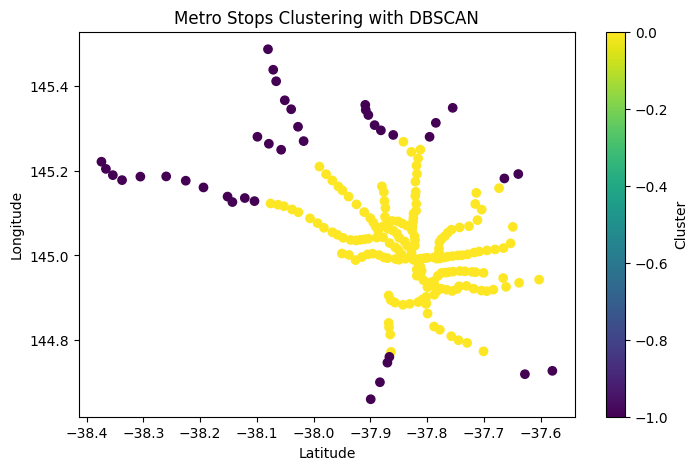

In [109]:
# fit the model
# eps is typically set by considering the geographical scale so (e.g., 0.001 for roughly 100 meters)
# initial random parameter values set by me.
dbscan = DBSCAN(eps=0.1, min_samples=20)
metro['cluster'] = dbscan.fit_predict(metro[['lat_metro', 'lon_metro']])

# visualize
plt.figure(figsize=(8, 5))
plt.scatter(metro['lat_metro'], metro['lon_metro'], c=metro['cluster'], cmap='viridis', marker='o', label='Metro stations')
plt.title('Metro Stops Clustering with DBSCAN')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.colorbar(label='Cluster')
plt.show()

In [110]:
metro.cluster.value_counts()

 0    180
-1     39
Name: cluster, dtype: int64

In [111]:
lat_long = metro[["lat_metro", "lon_metro"]]
X = lat_long.to_numpy()

In [112]:
# implementing grid search 
# epsilons to try 
epsilons = np.linspace(0.001, 3, num=20)

# min_samples to try
min_samples = np.arange(2,25, step = 3)


# to get combiantions of (eps, mmin_samples)
import itertools
all_combinations = list(itertools.product(epsilons, min_samples))
# all_combinations

In [113]:
iteration_num = len(all_combinations) 

In [114]:
def score_and_labels(all_combinations, X):
    all_scores = [] 
    all_labels_list = [] 

    # to perfrom dbscan on all possible operations by using for loop to go through each combination iteratively
    for i, (eps, num_samples) in enumerate (all_combinations):
        dbscan_model= DBSCAN(eps=eps, min_samples=num_samples)
        dbscan_model.fit_predict(X)
        labels = dbscan_model.labels_
        unique_labels = set(labels)
        num_clusters = len(unique_labels)
        
        # cluster size of less than 2 does not give any isngihts and above 80 are too cluttered , score of -1 is bad
        if(num_clusters < 2) or (num_clusters > 50):
            all_scores.append(-1000) # ignore this score 
            all_labels_list.append("Ignore")  # ignore this label 
            print(f"Ignored:    {eps, num_samples, num_clusters} .... {i} out of total {iteration_num} iterations")
            continue

        all_scores.append(ss(X, labels))
        all_labels_list.append(labels)


        print(f"Index: {i}, Score: {all_scores[-1]}, NumClusters: {len(unique_labels)}")

    # optimal values  
    opt_index = np.argmax(all_scores)   # gives index of - highest score out of all scores 
    opt_combination = all_combinations[opt_index]  # the combination taht gives teh best score 
    opt_labels = all_labels_list[opt_index]  # the labels associated to the best score & combinations
    opt_score = all_scores[opt_index]    # The best score itself. 


    return {'optimal epsilon': opt_combination[0],
            'optimal min samples' : opt_combination[1], 
            'optimal labels' : opt_labels,
            'optimal score': opt_score }
            
        
        
optimal_values = score_and_labels(all_combinations, X)


Ignored:    (0.001, 2, 1) .... 0 out of total 160 iterations
Ignored:    (0.001, 5, 1) .... 1 out of total 160 iterations
Ignored:    (0.001, 8, 1) .... 2 out of total 160 iterations
Ignored:    (0.001, 11, 1) .... 3 out of total 160 iterations
Ignored:    (0.001, 14, 1) .... 4 out of total 160 iterations
Ignored:    (0.001, 17, 1) .... 5 out of total 160 iterations
Ignored:    (0.001, 20, 1) .... 6 out of total 160 iterations
Ignored:    (0.001, 23, 1) .... 7 out of total 160 iterations
Ignored:    (0.1588421052631579, 2, 1) .... 8 out of total 160 iterations
Ignored:    (0.1588421052631579, 5, 1) .... 9 out of total 160 iterations
Ignored:    (0.1588421052631579, 8, 1) .... 10 out of total 160 iterations
Ignored:    (0.1588421052631579, 11, 1) .... 11 out of total 160 iterations
Index: 12, Score: 0.5556365112448332, NumClusters: 2
Index: 13, Score: 0.5598511511235684, NumClusters: 2
Index: 14, Score: 0.5526131864556187, NumClusters: 2
Index: 15, Score: 0.5531837329995933, NumClusters

In [115]:
optimal_values

{'optimal epsilon': 0.1588421052631579,
 'optimal min samples': 17,
 'optimal labels': array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0, -1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
  

In [116]:
dbscan = DBSCAN(eps=optimal_values['optimal epsilon'], min_samples=optimal_values['optimal min samples'])
metro['cluster'] = dbscan.fit_predict(metro[['lat_metro', 'lon_metro']])

In [117]:
metro.cluster.value_counts()

 0    213
-1      6
Name: cluster, dtype: int64

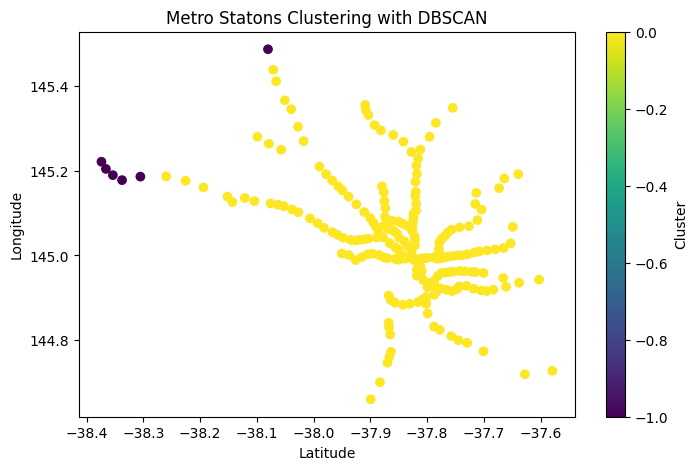

In [118]:
# visualize
plt.figure(figsize=(8, 5))
plt.scatter(metro['lat_metro'], metro['lon_metro'], c=metro['cluster'], cmap='viridis', marker='o', label='Metro Stations')
plt.title('Metro Statons Clustering with DBSCAN')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.colorbar(label='Cluster')
plt.show()

In [119]:
metro.cluster

0      0
1      0
2      0
3      0
4      0
      ..
214    0
215    0
216    0
217    0
218    0
Name: cluster, Length: 219, dtype: int64

In [120]:
# coordinates ofunderserved areas 
underserved_metro = metro[metro.cluster.isin([-1])]
underserved_metro.reset_index(drop=True, inplace=True)

In [121]:
underserved_metro

,station_name,lat_metro,lon_metro,cluster
0,Crib Point,-38.366205,145.204236,-1
1,Hastings,-38.305454,145.185984,-1
2,Stony Point,-38.374052,145.221141,-1
3,Bittern,-38.337747,145.177739,-1
4,Morradoo,-38.353932,145.189499,-1
5,Pakenham,-38.080548,145.486511,-1


In [122]:
# visualization to show the locatin of underserved bus stops with red marker
m = folium.Map(location=[metro['lat_metro'].mean(), metro['lon_metro'].mean()], zoom_start=10)

# Add bus stops to the map
for idx, row in metro.iterrows():
    folium.CircleMarker(
        location=[row['lat_metro'], row['lon_metro']],
        radius=5,
        color='green',
        fill=True,
        fill_color='blue'
    ).add_to(m)

# Display the map
# m.save('metro.html')
for i, rows in underserved_metro.iterrows():
    folium.Marker(location=[rows["lat_metro"], rows["lon_metro"]], icon=folium.Icon(color='red')).add_to(m)

m

This map visualizes metro stations in and around Melbourne, with green markers representing regularly served stations and red markers highlighting stations identified as underserved, which received a clustering label of -1. This labeling typically indicates that these stations are outliers or anomalous within the clustering model used, possibly due to their distinct characteristics or locations. Here's what can be inferred from this plot:

1. **Distribution of Underserved Stations**: The red markers, signifying underserved metro stations, are predominantly located on the outskirts of the metropolitan area. This spatial pattern suggests that peripheral or less centrally located stations are not as well served as those closer to the city center.

2. **Central Cluster of Well-Served Stations**: The dense clustering of green markers around the central and northeastern parts of the city indicates a high concentration of well-served metro stations. These areas likely benefit from more frequent services, better connectivity, and potentially more passenge
3. **Potential for Transit Deserts**: Areas without nearby metro stations can become transit deserts, where residents are forced to rely heavily on private vehicles or other less efficient forms of transportation. This reliance can lead to increased traffic congestion, higher transportation costs, and greater environmental impacts due to increased vehicle emissions.

4. **Strategic Development and Investment**: For urban development and transportation planning, this map can guide where investments might be most needed to elevate the quality and reach of public transport services. Focusing on underserved stations could also help in promoting more balanced urban growth and reducing congestion in over-served areas.


Overall, this visualization aids in understanding how metro services are distributed across Melbourne, highlighting areas where strategic interventions can improve public transit accessibility and efficiency.nd efficiency.

In [123]:
# pip install haversine

In [124]:
# a function taht calculates the distance beween each pair of points 

def calculate_distances(df):
    n = len(df)
    distance_matrix = np.zeros((n, n))  #empty matrix
    hv_matrix = np.zeros((n,n))
    for i in range(n):
        for j in range(i + 1, n):  # Loop over each pair once
            point1 = (df.loc[i, 'lat_metro'], df.loc[i, 'lon_metro'])
            point2 = (df.loc[j, 'lat_metro'], df.loc[j, 'lon_metro'])
            
            distance = geodesic(point1, point2).kilometers  # Distance in kilometers
            distance_matrix[i, j] = distance
            distance_matrix[j, i] = distance  # Symmetric matrix

            # harvesine distance
            hs_distance = hs.haversine(point1,point2)
            hv_matrix[i,j] = hs_distance
            hv_matrix[j,i] = hs_distance 

            
    return distance_matrix, hv_matrix

# Calculate the distance matrix for underserved metro stations
dist_matrix, hv_matrix = calculate_distances(underserved_metro)

# Calculate the distance matrix for all metro stations 
dist_matrix_all_mt, hv_matrix_all_mt = calculate_distances(metro)

#  convert to a DataFrame for nicer display
underserved_distance_df = pd.DataFrame(dist_matrix, index=underserved_metro.index, columns=underserved_metro.index)

In [125]:
underserved_distance_df

,0,1,2,3,4,5
0,0.000000,6.929773,1.714985,3.917050,1.874835,40.203942
1,6.929773,0.000000,8.211514,3.656398,5.389960,36.281164
2,1.714985,8.211514,0.000000,5.534630,3.554640,40.016363
3,3.917050,3.656398,5.534630,0.000000,2.069923,39.323995
4,1.874835,5.389960,3.554640,2.069923,0.000000,39.967367
5,40.203942,36.281164,40.016363,39.323995,39.967367,0.000000


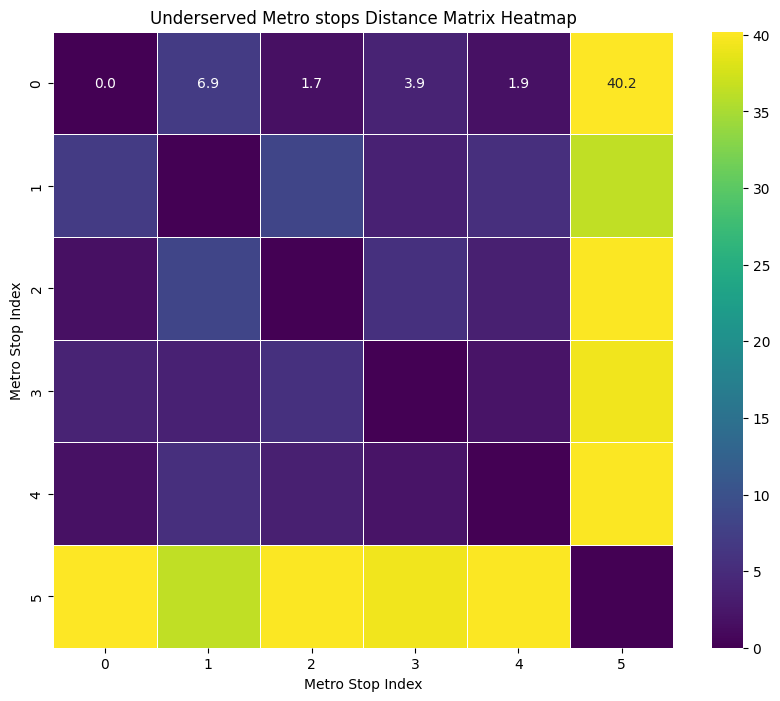

In [126]:
plt.figure(figsize=(10, 8))  # Set the figure size for the heatmap
sns.heatmap(underserved_distance_df, annot=True, fmt=".1f", cmap='viridis', linewidths=.5)
plt.title('Underserved Metro stops Distance Matrix Heatmap')
plt.xlabel('Metro Stop Index')
plt.ylabel('Metro Stop Index')
plt.show()

This heatmap displays a distance matrix for underserved metro stops, where each cell represents the distance in kilometers between pairs of metro stops. The distances are color-coded, with different colors representing different ranges of distances:

1. **Zero Distance**: The diagonal cells, where the metro stop index matches on both axes (e.g., 0-0, 1-1), show a distance of 0.0 kilometers, naturally indicating the distance from a stop to itself.

2. **Short Distances**: Purple cells, such as the distance between metro stops 0 and 2 (1.7 km) or between 0 and 4 (3.9 km), represent shorter distances. These stops are relatively close to each other, suggesting that they could potentially serve overlapping areas.

3. **Moderate Distances**: Darker purple and blue cells show moderate distances between stops, which could indicate stops that are adequately spaced, providing service to distinct areas without significant overlap.

4. **Long Distances**: Bright yellow cells, particularly notable between metro stop 5 and others like 0, 1, and 3 (40.2 km), indicate very long distances between these stops. This suggests that these areas are significantly underserved and could benefit from additional stops or better transportation options to bridge the gap between existing stoices.
   - **Route Optimization**: Understanding the distances between stops can aid in optimizing routes for efficiency and coverage. For example, planning new routes or adjusting existing ones could address areas marked by longer distances on the erved areas.

Overall, the heatmap provides valuable insights into the spatial distribution and connectivity of metro services, especially highlighting critical gaps that need addressing to enhance the effectiveness and reach of public transportation.

In [127]:
metro_map = folium.Map(location=[underserved_metro['lat_metro'].mean(), underserved_metro['lon_metro'].mean()], zoom_start=13)

# Threshold distance (e.g., 5 kilometers)
threshold = 10
df = underserved_metro
for i in range(len(df)):
    for j in range(len(df)):
        if i != j and pd.DataFrame(hv_matrix).iloc[i, j] > threshold:
            folium.PolyLine(
                locations=[(df.iloc[i]['lat_metro'], df.iloc[i]['lon_metro']), 
                           (df.iloc[j]['lat_metro'], df.iloc[j]['lon_metro'])],
                color='teal',
                weight=4,
                tooltip=f'{pd.DataFrame(hv_matrix).iloc[i, j]:.2f} km'
            ).add_to(metro_map)

            

# Add bus stops to the map
for idx, row in metro.iterrows():
    folium.CircleMarker(
        location=[row['lat_metro'], row['lon_metro']],
        radius=5,
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(metro_map)

# Display the map
# m.save('metro.html')
for i, rows in underserved_metro.iterrows():
    folium.Marker(location=[rows["lat_metro"], rows["lon_metro"]], icon=folium.Icon(color='red')).add_to(m)

            
metro_map

From the map depicting the metro stations and the lines indicating distances greater than 10 kilometers between stations, several insights can be drawn regarding the distribution and service of underserved metro stations from the map above:

1. **Spatial Isolation of Underserved Stations**: The teal lines highlight that some metro stations are more than 10 kilometers apart from their nearest neighbors. These lines predominantly connect stations on the outskirts of the map, especially towards the southeast. This suggests a significant spatial isolation of these stations, indicating they are likely underserved in terms of frequency of service and connectivity.

2. **Potential for Expansion in Coverage**: The presence of long distances between certain stations implies that there are large areas within the city that could benefit from either new metro stations or improved service to existing stations. This would help in reducing the transit gaps and enhancing accessibility for residents in these outlying areas.

3. **Focus Areas for Development**: The areas where these long-distance lines are concentrated, particularly the corridors extending southeast, highlight specific regions where transit infrastructure development could be prioritized. Developing these areas could involve adding new routes, increasing the frequency of existing services, or constructing new stations to bridge the large gaps.

4. **Equity in Transit Services**: Ensuring that these underserved and isolated stations receive improved services could also address issues of equity in public transportation access. Residents in these areas may currently face longer travel times and less frequent service, impacting their mobility and access to city resources.

Overall, this map provides a clear visual tool for identifying gaps in metro service coverage and can help guide future investments in public transportation infrastructure to achieve a more balanced and effective transit network across the metropolitan area.

In [128]:
# to understand the distance between all metro stations that are close to each other (about 5km apart) and maybe a few that might be isolated 
metro_map = folium.Map(location=[metro['lat_metro'].mean(), metro['lon_metro'].mean()], zoom_start=13)

# Threshold distance (e.g., 5 kilometers)
threshold = 5
df = metro

# to show metro stops that are less than 5 km apart 
for i in range(len(df)):
    for j in range(len(df)):
        # shows the statons who are "threshold" km around each other
        if i != j and pd.DataFrame(hv_matrix_all_mt).iloc[i, j] < threshold:
            folium.PolyLine(
                locations=[(df.iloc[i]['lat_metro'], df.iloc[i]['lon_metro']), 
                           (df.iloc[j]['lat_metro'], df.iloc[j]['lon_metro'])],
                color='teal',
                weight=3,
                tooltip=f'{round((pd.DataFrame(hv_matrix_all_mt).iloc[i, j]),2)} km'
            ).add_to(metro_map)

        

# Add bus stops to the map
for idx, row in metro.iterrows():
    folium.CircleMarker(
        location=[row['lat_metro'], row['lon_metro']],
        radius=5,
        color='blue',
        fill=True,
        fill_color='green'
    ).add_to(metro_map)

# Display the map
# m.save('metro.html')


            
metro_map

The  map help in visualizing the distribution of metro stations across a geographic area, highlighting the proximity of stations to each other based on a specified distance threshold (in this case, 5 kilometers). Here's what can be understood and how optimization might be approached:
p:
1. **Distance Highlighting**: The code uses teal lines to connect metro stations that are less than 5 kilometers apart. This visualization helps identify clusters of metro stations that are densely packed, as well as possibly indicating areas where stations might be redundantly close to each other.

2. **Station Distribution**: The distribution of metro stations, as shown by the blue circle markers, provides a visual representation of how well different areas are served. The clustering of lines in certain areas suggests good local connectivity, whereas areas with fewer or no lines might be underserved.

3. **Areas of Potential Over-service and Under-service**: Dense clusters of teal lines might suggest areas where stations could be considered excessive or too closely spaced. Conversely, large areas without teal lines or stations indicate regions that might be underserved and could benefit from the addition of new stations or the extension of existingS4rategies:
1. **Reviewing Station Spacing**: The areas with dense teal lines can be reviewed to determine if some stations are unnecessarily close, which might be inefficient in terms of operational costs and resource allocation. Removing or consolidating some stations might improve the overall efficiency of th5 network.

2. **Expanding Coverage**: For regions on the map devoid of stations or connectivity (teal lines), strategic placement of new metro stations can help expand the reach of public transport, making it more accessible to wider populations. This can help in reducing transit deserts and improving connectivity for subud rural

   rOfurbished statioerall, sthe map and code provide a foundational tool for analyzing metro station distribution and identifying key areas for potential optimization to enhance service efficiency, coverage, and passenger satisfaction.

<h2>Conclusion</h2>

Concluding the analysis of metro and bus transportation systems in the City of Melbourne, several key insights and actionable recommendations have been developed to optimize public transit and meet the demands of a growing urban population:

1. **Strategic Expansion and Optimization**: The project has identified critical gaps in transit coverage, particularly in peripheral and rapidly growing suburban areas. To address these gaps, the strategic placement of new metro and bus stations is recommended. Additionally, the optimization of existing routes and the potential consolidation of underutilized stations could significantly enhance service efficiency and reduce operational costs.

2. **Integration of Multimodal Transportation**: A significant finding of this project is the need for better integration between different modes of public transport. Creating multimodal transportation hubs that connect metro, bus, and other transportation modes can significantly improve the usability of the public transit system, making it more convenient for users to travel across different parts of the city and beyond.

3. **Data-Driven Planning**: Utilizing advanced data analytics and geographical information systems (GIS) has proven invaluable in understanding patterns of service use and area demographics. Continuing to leverage data will be crucial in making informed decisions that respond dynamically to future changes in population and urban development.

4. **Community Engagement and Feedback**: Engaging with local communities to gather feedback on public transportation has highlighted the need for more user-focused services. Continued engagement through surveys, public forums, and feedback channels should be a priority to ensure that the transit system evolves in alignment with user needs and expectations.


In conclusion, this project provides a comprehensive roadmap for enhancing Melbourne's public transit system. By focusing on strategic development, integration, and sustainability, Melbourne can ensure that its transportation network meets current demands and is prepared for future challenges, ultimately making the city more livable and accessible for all its residents.

<h2>Reference List</h2>

Abba, IV 2023, How to Rename a Column in Pandas – Python Pandas Dataframe Renaming Tutorial, freeCodeCamp.org, viewed 14 April 2024, <https://www.freecodecamp.org/news/how-to-rename-a-column-in-pandas/>.

City of Melbourne Open Data Team 2018, Metro Train Stations with Accessibility Information, data.melbourne.vic.gov.au, viewed 13 April 2024, <https://data.melbourne.vic.gov.au/explore/dataset/metro-train-stations-with-accessibility-information/information/>.

Creating multiple subplots using plt.subplots — Matplotlib 3.4.1 documentation n.d., matplotlib.org.

Dejan, G 2021, The Magic of Haversine Distance, Ninja Van Tech.

Demo of DBSCAN clustering algorithm n.d., scikit-learn.

Duke University 2024, Introduction to ARIMA models, Duke.edu, viewed 1 May 2024, <https://people.duke.edu/~rnau/411arim.htm#:~:text=ARIMA(p%2Cd%2Cq)%20forecasting%20equation%3A%20ARIMA>.

GeoDev 2023, Discover the power of GeoPandas for interactive map creation and geospatial data analysis, www.youtube.com, viewed 3 May 2024, <https://www.youtube.com/watch?v=xWB0w88cFO0&list=PLyWyQBSWLw1OF3RGVWToPkqe_pfx4TcPW&index=8>.

geopandas.GeoDataFrame — GeoPandas 0.14.4+0.g60c9773.dirty documentation n.d., geopandas.org, viewed 3 May 2024, <https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.html>.

Hogg, G 2022, DBSCAN Clustering Algorithm Explained Simply, www.youtube.com, viewed 14 May 2024, <https://www.youtube.com/watch?v=Lh2pAkNNX1g&t=180s>.

How Kernel Density works—ArcGIS Pro | Documentation n.d., pro.arcgis.com.

Jason Brownlee 2017, How to Create an ARIMA Model for Time Series Forecasting in Python, Machine Learning Mastery, viewed 1 May 2024, <https://machinelearningmastery.com/arima-for-time-series-forecasting-with-python/>.

Kanade, V 2022, What Is Spatial Analysis? Definition, Working, and Examples, Spiceworks.

matplotlib.pyplot.subplots — Matplotlib 3.6.0 documentation n.d., matplotlib.org.

NumPy — NumPy 2009, Numpy.org, viewed 14 April 2024, <https://numpy.org>.

numpy.ravel — NumPy v1.20 Manual n.d., numpy.org.

Olumide, S 2023, Dataframe Drop Column in Pandas – How to Remove Columns from Dataframes, freeCodeCamp.org, viewed 13 April 2024, <https://www.freecodecamp.org/news/dataframe-drop-column-in-pandas-how-to-remove-columns-from-dataframes/#:~:text=Method%20in%20Pandas->.

Pandas 2014, User Guide — pandas 1.0.1 documentation, Pydata.org, viewed 14 April 2024, <https://pandas.pydata.org/docs/user_guide/index.html>.

pandas (software) 2020, Wikipedia, viewed 14 April 2024, <https://en.wikipedia.org/wiki/Pandas_(software)>.

pandas.DataFrame.drop — pandas 1.3.2 documentation n.d., pandas.pydata.org, viewed 14 April 2024, <https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.drop.html>.

PiotrDev 2023, Reverse Geocode with Python, real example with reverse_geocode., Medium, viewed 29 April 2024, <https://medium.com/@pether.maciejewski/reverse-geocode-with-python-real-example-with-reverse-geocode-917c0357b32f>.

Prachisaini 2023, Geographical Visualization in Python: Mapping with Folium and Geopy, Medium, viewed 19 April 2024, <https://medium.com/@prachi1808saini/geographical-visualization-in-python-mapping-with-folium-and-geopy-51586c49a341>.

python mpl_toolkits installation issue n.d., Stack Overflow, viewed 8 May 2024, <https://stackoverflow.com/questions/37661119/python-mpl-toolkits-installation-issue>.

Reverse Geocoding Python to Convert Latitude Longitude to Address using Geopy Library n.d., www.youtube.com, viewed 29 April 2024, <https://www.youtube.com/watch?v=mhTkaH2YuAc>.

seaborn.boxplot — seaborn 0.11.1 documentation n.d., seaborn.pydata.org.

seaborn.scatterplot — seaborn 0.11.1 documentation n.d., seaborn.pydata.org.

Shatnawi, N, Al-Omari, AA & Al-Qudah, H 2020, ‘Optimization of Bus Stops Locations Using GIS Techniques and Artificial Intelligence’, Procedia Manufacturing, vol. 44, pp. 52–59.

sklearn.cluster.DBSCAN n.d., scikit-learn, viewed 14 May 2024, <https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html#:~:text=DBSCAN%20-%20Density-Based%20Spatial%20Clustering>.

sklearn.metrics.pairwise.haversine_distances n.d., scikit-learn.

Spatial Raster Metadata: CRS, Resolution, and Extent in Python 2018, Earth Data Science - Earth Lab, viewed 3 May 2024, <https://www.earthdatascience.org/courses/use-data-open-source-python/intro-raster-data-python/fundamentals-raster-data/raster-metadata-in-python/#:~:text=1.->.

Starmer, J 2022, Clustering with DBSCAN, Clearly Explained!!!, www.youtube.com.

UCI Machine Learning Repository n.d., archive.ics.uci.edu.

Understanding density analysis—ArcGIS Pro | Documentation n.d., pro.arcgis.com.

Welcome to GeoPy’s documentation! — GeoPy 1.21.0 documentation n.d., geopy.readthedocs.io.

Wikipedia Contributors 2019, NumPy, Wikipedia, Wikimedia Foundation, viewed 14 April 2024, <https://en.wikipedia.org/wiki/NumPy>.

Yusuf, S 2023, Data Visualization with Python (9): Generating Maps with Folium, Medium.